In [2]:
from sklearn.metrics import accuracy_score, auc, roc_auc_score, roc_curve, classification_report, f1_score, recall_score ,confusion_matrix
from sklearn.preprocessing import label_binarize
from statsmodels.stats.weightstats import DescrStatsW

from matplotlib import pyplot as plt
import cv2
import os 
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 
import sys
import glob
import argparse
import numpy as np
import pandas as pd
from scipy import interp
from itertools import cycle
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras.applications.resnet import preprocess_input
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.applications.efficientnet import EfficientNetB7,decode_predictions
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.models import Model
from sklearn.model_selection import StratifiedKFold,KFold

In [3]:
input_size = 512

def load_data(npy_path):
    print('-'*30)
    print('load images...')
    print('-'*30)
    
    for i, path in enumerate(npy_path):
        mask_npy_path = path.replace('_HE','_box')
        train_npy_path = path
    
        imgs_tmp = [cv2.imread(train_npy_path)]
        imgs_mask_tmp = [np.expand_dims(cv2.imread(mask_npy_path,0),-1)]
#         print(imgs_tmp.shape, imgs_mask_tmp.shape)
        
        if i==0:
            imgs = imgs_tmp
            imgs_mask = imgs_mask_tmp
            
        else:
            imgs = np.append(imgs, imgs_tmp,axis=0)
            imgs_mask = np.append(imgs_mask, imgs_mask_tmp,axis=0)
    imgs_tmp,imgs_mask_tmp = 0,0
    print('-'*30)
    print('imgs : {} \nmasks : {}'.format(imgs.shape, imgs_mask.shape))    
    print('-'*30)
    imgs = imgs.astype('float32')
    imgs_mask = imgs_mask.astype('float32')
    print('img : ', imgs.max())
    print('mask : ',imgs_mask.max())

    print('-'*30)
    print('normalization start...')
    print('-'*30)
    
    imgs = cv2.normalize(imgs, None, 0, 1, cv2.NORM_MINMAX)

    imgs_mask[imgs_mask<= 127] = 0
    imgs_mask[imgs_mask > 127] = 1

    print('img : ',imgs.max())
    print('mask : ',imgs_mask.max())

    return imgs, imgs_mask

In [4]:
df = pd.read_csv('all_filter_box.csv')
box = pd.read_csv('box.csv')

In [5]:
df

,path,mask,class
0,res_box/2015/1013_HE.png,res_box/2015/1013_box.png,a
1,res_box/2015/1014_HE.png,res_box/2015/1014_box.png,a
2,res_box/2015/1015_HE.png,res_box/2015/1015_box.png,a
3,res_box/2015/1016_HE.png,res_box/2015/1016_box.png,c
4,res_box/2015/1024_HE.png,res_box/2015/1024_box.png,a
...,...,...,...
935,res_box/normal/880000_HE.png,res_box/normal/880000_box.png,normal
936,res_box/normal/940000_HE.png,res_box/normal/940000_box.png,normal
937,res_box/normal/950000_HE.png,res_box/normal/950000_box.png,normal
938,res_box/normal/970000_HE.png,res_box/normal/970000_box.png,normal


In [6]:

box['x1'] = box['x1']*(input_size/box['size'])
box['x2'] = box['x2']*(input_size/box['size'])
box['y1'] = box['y1']*(input_size/box['size'])
box['y2'] = box['y2']*(input_size/box['size'])

In [7]:
box.iloc[66]

Unnamed: 0            66
path            1060.png
x1            245.479452
y1            317.316729
x2             283.73599
y2            346.009132
class           fracture
grade                  a
width               2409
height              2116
size                2409
Name: 66, dtype: object

In [8]:
kf = KFold(n_splits=5, random_state=333, shuffle=True)
foldnum=0
for train_index, test_index in kf.split(df):
    train, test = df.iloc[train_index], df.iloc[test_index]
    if 'res_box/2020/102_HE.png' in list(test.path):
        print(foldnum)

0


In [9]:
list(test.path)

['res_box/2015/1059_HE.png',
 'res_box/2015/1061_HE.png',
 'res_box/2015/1066_HE.png',
 'res_box/2015/1085_HE.png',
 'res_box/2015/1087_HE.png',
 'res_box/2015/1102_HE.png',
 'res_box/2015/1104_HE.png',
 'res_box/2015/1106_HE.png',
 'res_box/2015/1107_HE.png',
 'res_box/2015/1112_HE.png',
 'res_box/2015/1114_HE.png',
 'res_box/2015/1124_HE.png',
 'res_box/2015/1127_HE.png',
 'res_box/2015/1128_HE.png',
 'res_box/2015/1132_HE.png',
 'res_box/2015/1144_HE.png',
 'res_box/2015/1145_HE.png',
 'res_box/2015/1148_HE.png',
 'res_box/2015/1159_HE.png',
 'res_box/2015/1182_HE.png',
 'res_box/2015/1183_HE.png',
 'res_box/2015/1184_HE.png',
 'res_box/2015/1189_HE.png',
 'res_box/2015/1193_HE.png',
 'res_box/2016/1006_HE.png',
 'res_box/2016/859_HE.png',
 'res_box/2016/860_HE.png',
 'res_box/2016/867_HE.png',
 'res_box/2016/868_HE.png',
 'res_box/2016/874_HE.png',
 'res_box/2016/876_HE.png',
 'res_box/2016/880_HE.png',
 'res_box/2016/883_HE.png',
 'res_box/2016/887_HE.png',
 'res_box/2016/892_HE.p

------------------------------
load images...
------------------------------
------------------------------
imgs : (188, 512, 512, 3) 
masks : (188, 512, 512, 1)
------------------------------
img :  255.0
mask :  255.0
------------------------------
normalization start...
------------------------------
img :  1.0
mask :  1.0
6/6 [==============================] - 3s 258ms/step
              precision    recall  f1-score   support

           0       0.73      0.85      0.78        84
           1       0.66      0.64      0.65        45
           2       0.72      0.52      0.60        25
           3       0.90      0.76      0.83        34

    accuracy                           0.74       188
   macro avg       0.75      0.69      0.72       188
weighted avg       0.74      0.74      0.74       188

0.7429890487649486
0.07806218604330566
0.7393617021276596
0.11727453043110672
0.7362030123195562
0.08079702133017268
0.8452354006337708
0.05923955171515942


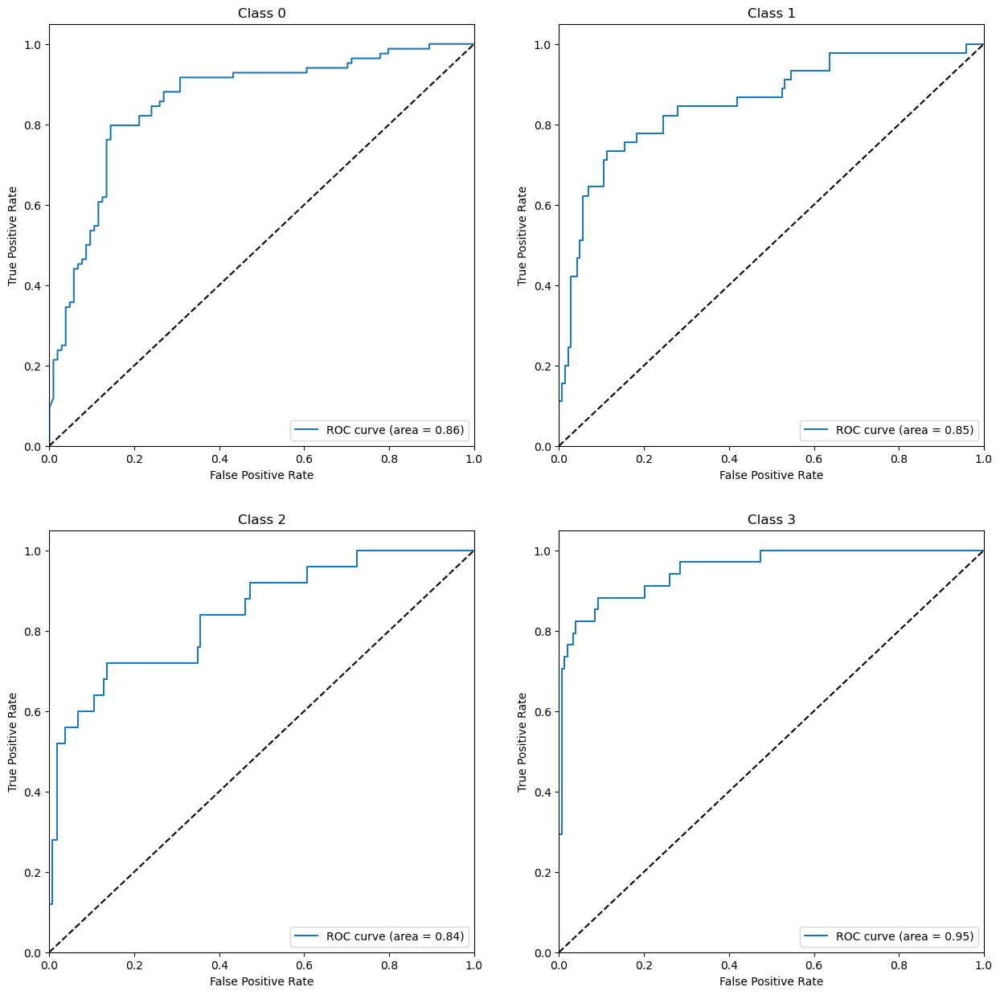

/data01/anaconda3/envs/jeon2/lib/python3.7/site-packages/ipykernel_launcher.py:84: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


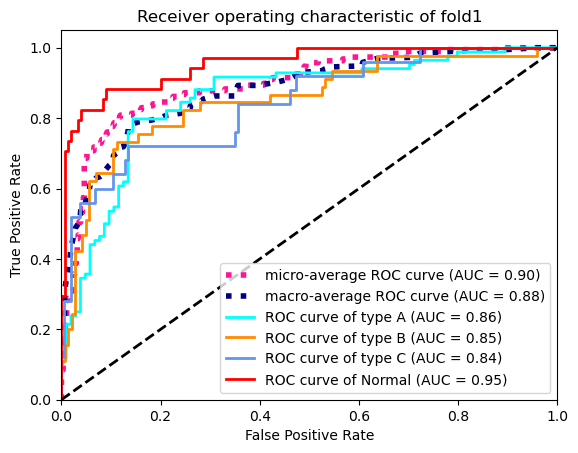

------------------------------
load images...
------------------------------
------------------------------
imgs : (188, 512, 512, 3) 
masks : (188, 512, 512, 1)
------------------------------
img :  255.0
mask :  255.0
------------------------------
normalization start...
------------------------------
img :  1.0
mask :  1.0
6/6 [==============================] - 3s 259ms/step
              precision    recall  f1-score   support

           0       0.77      0.85      0.81        86
           1       0.77      0.60      0.68        40
           2       0.75      0.75      0.75        24
           3       0.76      0.76      0.76        38

    accuracy                           0.77       188
   macro avg       0.76      0.74      0.75       188
weighted avg       0.77      0.77      0.76       188

0.7662337896904237
0.007176212109697731
0.7659574468085106
0.09531324338046651
0.7628320173775697
0.050140232558068695
0.8613060208239022
0.0467756543429158


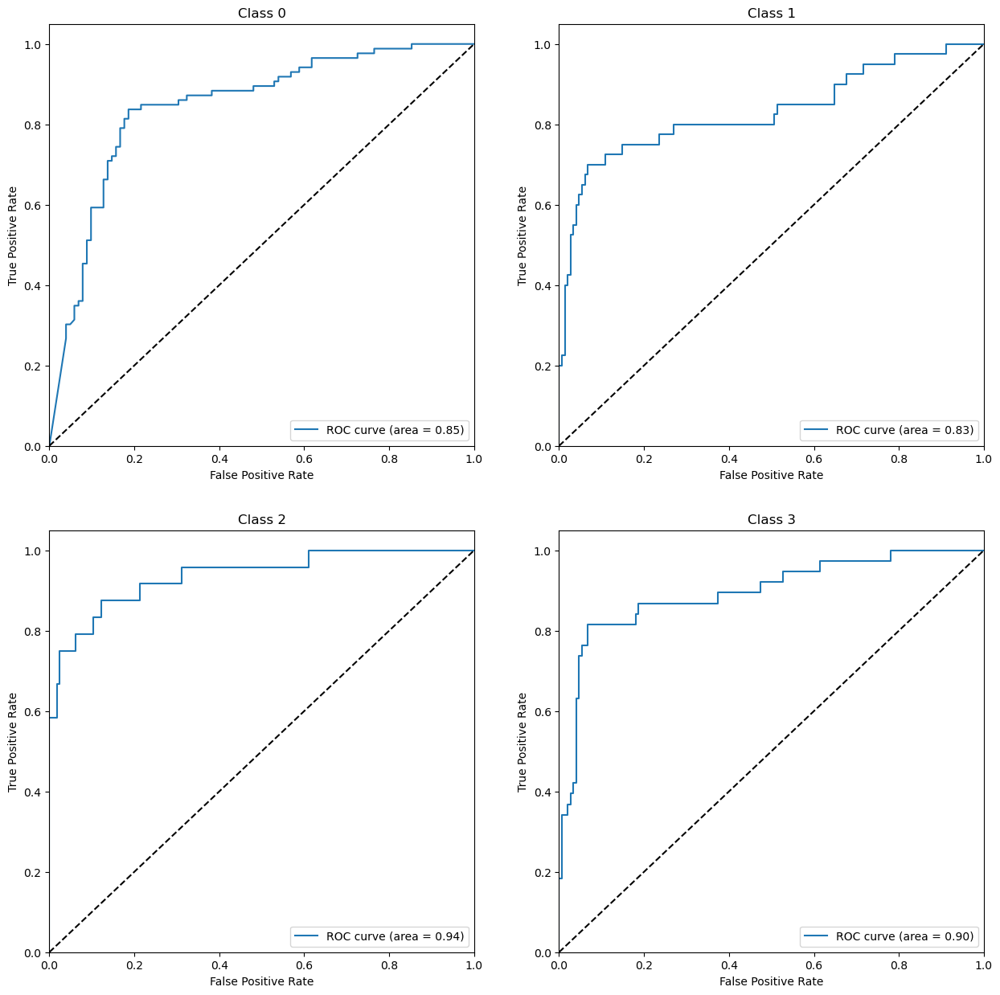

/data01/anaconda3/envs/jeon2/lib/python3.7/site-packages/ipykernel_launcher.py:84: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


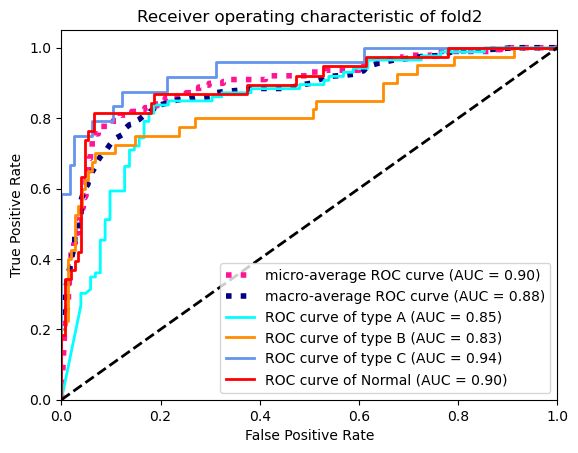

------------------------------
load images...
------------------------------
------------------------------
imgs : (188, 512, 512, 3) 
masks : (188, 512, 512, 1)
------------------------------
img :  255.0
mask :  255.0
------------------------------
normalization start...
------------------------------
img :  1.0
mask :  1.0
6/6 [==============================] - 4s 260ms/step
              precision    recall  f1-score   support

           0       0.70      0.78      0.74        88
           1       0.61      0.58      0.59        38
           2       0.65      0.56      0.60        27
           3       0.80      0.69      0.74        35

    accuracy                           0.69       188
   macro avg       0.69      0.65      0.67       188
weighted avg       0.69      0.69      0.69       188

0.6923630383389866
0.06126336021192894
0.6914893617021277
0.0963497972584298
0.689265558039025
0.0673867090842675
0.8136317338162065
0.07340472873723576


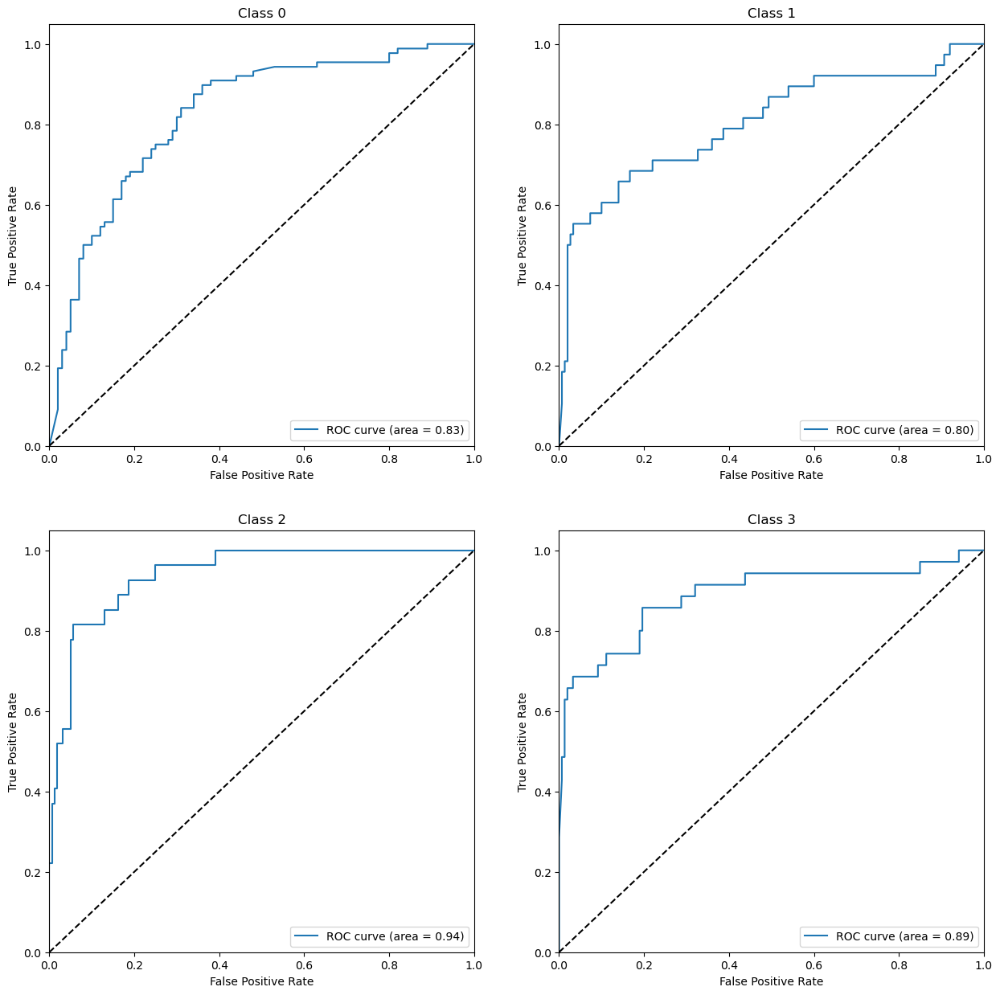

/data01/anaconda3/envs/jeon2/lib/python3.7/site-packages/ipykernel_launcher.py:84: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


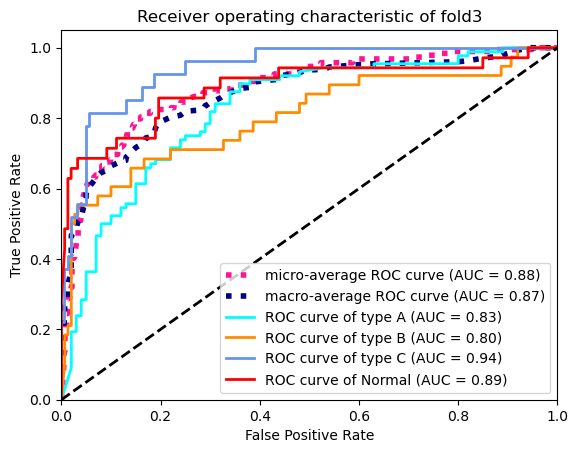

------------------------------
load images...
------------------------------
------------------------------
imgs : (188, 512, 512, 3) 
masks : (188, 512, 512, 1)
------------------------------
img :  255.0
mask :  255.0
------------------------------
normalization start...
------------------------------
img :  1.0
mask :  1.0
6/6 [==============================] - 3s 259ms/step
              precision    recall  f1-score   support

           0       0.72      0.74      0.73        86
           1       0.57      0.51      0.54        45
           2       0.54      0.56      0.55        25
           3       0.76      0.78      0.77        32

    accuracy                           0.67       188
   macro avg       0.65      0.65      0.65       188
weighted avg       0.67      0.67      0.67       188

0.667136485814767
0.083053561760221
0.6702127659574468
0.11109335144893889
0.6680674102701636
0.09678290452011724
0.8061339972838388
0.06636604571414263


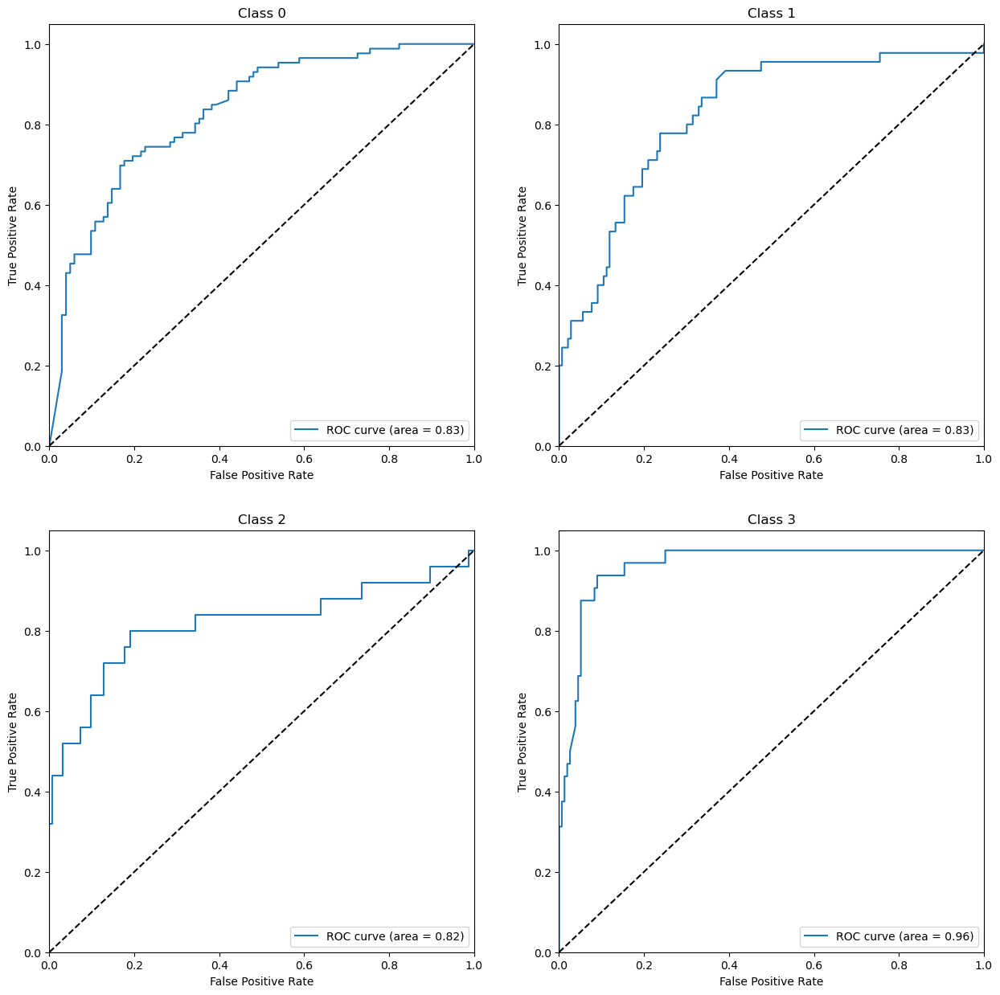

/data01/anaconda3/envs/jeon2/lib/python3.7/site-packages/ipykernel_launcher.py:84: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


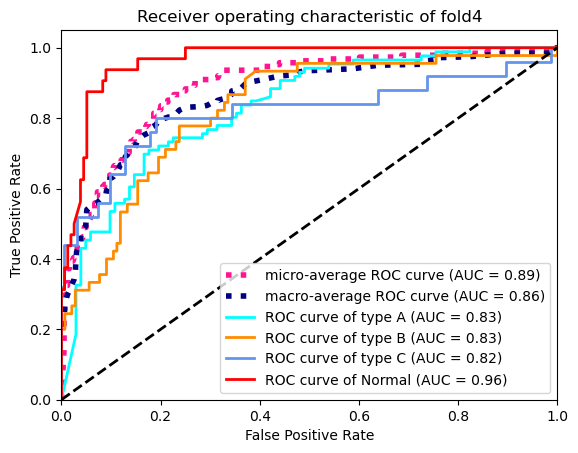

------------------------------
load images...
------------------------------
------------------------------
imgs : (188, 512, 512, 3) 
masks : (188, 512, 512, 1)
------------------------------
img :  255.0
mask :  255.0
------------------------------
normalization start...
------------------------------
img :  1.0
mask :  1.0
6/6 [==============================] - 3s 260ms/step
              precision    recall  f1-score   support

           0       0.80      0.85      0.83       103
           1       0.65      0.54      0.59        28
           2       0.78      0.72      0.75        29
           3       0.71      0.71      0.71        28

    accuracy                           0.77       188
   macro avg       0.74      0.71      0.72       188
weighted avg       0.76      0.77      0.76       188

0.7617894953232603
0.054597149218771984
0.7659574468085106
0.11363980064019646
0.7623860077444223
0.08462137884906094
0.8513750565866909
0.05422027683189377


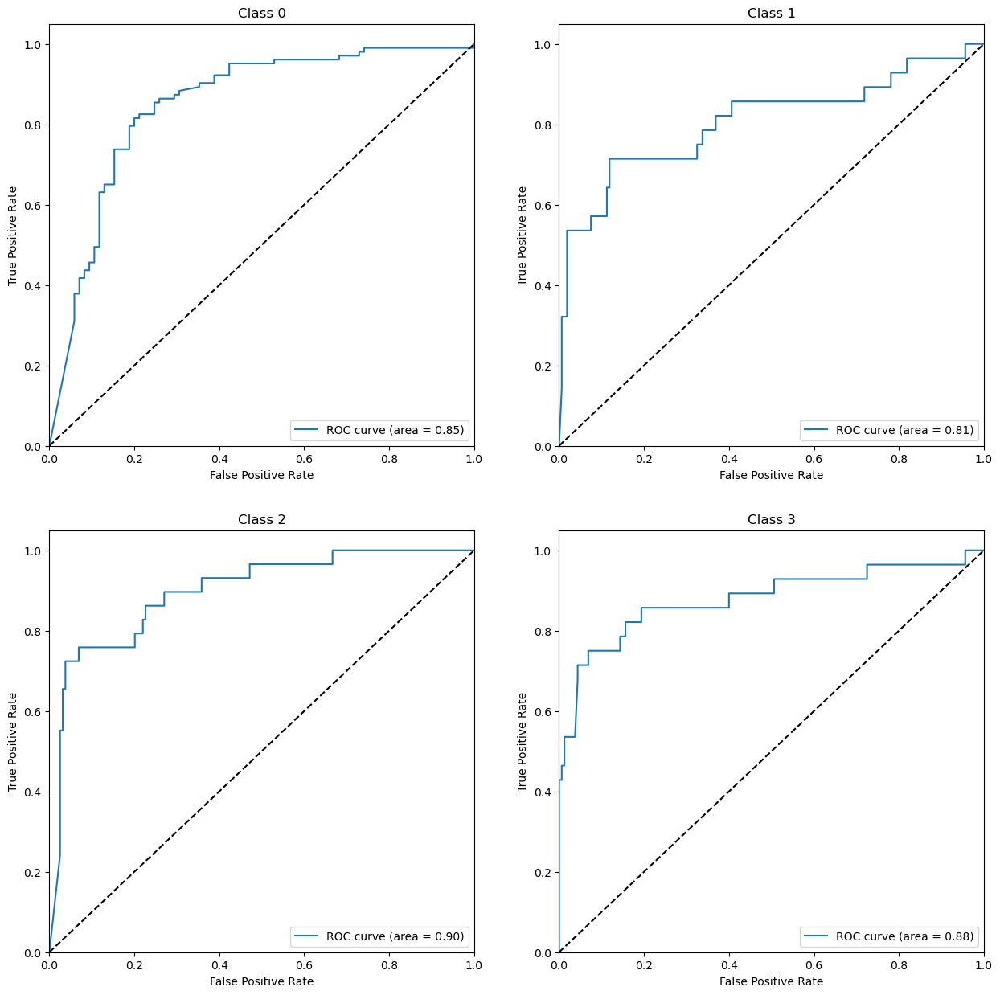

/data01/anaconda3/envs/jeon2/lib/python3.7/site-packages/ipykernel_launcher.py:84: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


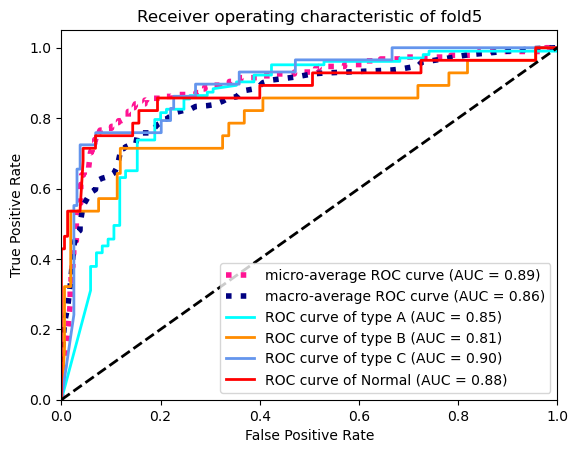

In [37]:
kf = KFold(n_splits=5, random_state=333, shuffle=True)
foldnum=0
for train_index, test_index in kf.split(df):
#     if foldnum != 2:
#         foldnum += 1
#         continue
    model=load_model("model/last_box_{}.h5".format(foldnum))
    
    train, test = df.iloc[train_index], df.iloc[test_index]
    
    imgs_test,imgs_mask_test = load_data(test.path)
    
    result=model.predict([imgs_test,imgs_mask_test],verbose=1)

    y_test = pd.get_dummies(test['class']).to_numpy()
    
    name_test = test['path']
    
#     for i in range(len(result)):
#         print(np.argmax(result[i]),np.argmax(y_test[i]))

    print(classification_report(np.argmax(y_test,-1),np.argmax(result,-1)))
    CR = classification_report(np.argmax(y_test,-1),np.argmax(result,-1),output_dict=True)
    precision = [CR['0']['precision'],CR['1']['precision'],CR['2']['precision'],CR['3']['precision']]
    recall = [CR['0']['recall'],CR['1']['recall'],CR['2']['recall'],CR['3']['recall']]
    f1 = [CR['0']['f1-score'],CR['1']['f1-score'],CR['2']['f1-score'],CR['3']['f1-score']]
    weights = [CR['0']['support'],CR['1']['support'],CR['2']['support'],CR['3']['support']]
    print(DescrStatsW(precision, weights=weights, ddof=1).mean)
    print(DescrStatsW(precision, weights=weights, ddof=1).std)
    print(DescrStatsW(recall, weights=weights, ddof=1).mean)
    print(DescrStatsW(recall, weights=weights, ddof=1).std)
    print(DescrStatsW(f1, weights=weights, ddof=1).mean)
    print(DescrStatsW(f1, weights=weights, ddof=1).std)
    
#     for i in range(len(y_test)):
#         print(np.argmax(y_test[i]),np.argmax(result[i]),test_generator.filenames[i])
    cm = confusion_matrix(np.argmax(y_test,-1),np.argmax(result,-1))
    
    for idx, cls in enumerate(classes):
        # True negatives are all the samples that are not our current GT class (not the current row) 
        # and were not predicted as the current class (not the current column)
        true_negatives = np.sum(np.delete(np.delete(cm, idx, axis=0), idx, axis=1))

        # True positives are all the samples of our current GT class that were predicted as such
        true_positives = cm[idx, idx]

        # The accuracy for the current class is the ratio between correct predictions to all predictions
        per_class_accuracies[cls] = (true_positives + true_negatives) / np.sum(cm)
    acc = list(per_class_accuracies.values())
    print(DescrStatsW(acc, weights=weights, ddof=1).mean)
    print(DescrStatsW(acc, weights=weights, ddof=1).std)
    
    n_classes = 4
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test[:, i], result[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    plt.figure(figsize=(15, 15))
    for idx, i in enumerate(range(n_classes)):
        plt.subplot(221+idx)
        plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.2f)' % roc_auc[i])
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Class %0.0f' % idx)
        plt.legend(loc="lower right")
    plt.show()


    lw = 2
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), result.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += interp(all_fpr, fpr[i], tpr[i])

    # Finally average it and compute AUC
    mean_tpr /= n_classes
    
    types=['type A','type B','type C','Normal']

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Plot all ROC curves
    plt.figure()
    plt.plot(fpr["micro"], tpr["micro"],
             label='micro-average ROC curve (AUC = {0:0.2f})'
                   ''.format(roc_auc["micro"]),
             color='deeppink', linestyle=':', linewidth=4)

    plt.plot(fpr["macro"], tpr["macro"],
             label='macro-average ROC curve (AUC = {0:0.2f})'
                   ''.format(roc_auc["macro"]),
             color='navy', linestyle=':', linewidth=4)

    colors = cycle(['aqua', 'darkorange', 'cornflowerblue','red'])
    for i, color in zip(range(n_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=lw,
                 label='ROC curve of {0} (AUC = {1:0.2f})'
                 ''.format(types[i], roc_auc[i]))

    plt.plot([0, 1], [0, 1], 'k--', lw=lw)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic of fold{}'.format(foldnum+1))
    plt.legend(loc="lower right")
    plt.show()
    foldnum += 1

In [11]:
acc = [0.8397,0.8702,0.9313,0.9237]
np.average(acc)

0.8912249999999999

In [12]:
np.argmax(y_test,-1),np.argmax(result,-1)

array([[69,  8,  6,  5],
       [14, 22,  1,  1],
       [ 9,  3, 15,  0],
       [ 7,  3,  1, 24]])

In [23]:
classes = [0,1,2,3]

In [26]:
per_class_accuracies = {}


In [36]:
list(per_class_accuracies.values())

[0.7393617021276596,
 0.8404255319148937,
 0.8936170212765957,
 0.9095744680851063]

In [20]:
a

col_0,0,1,2,3
row_0,,,,
0,69,8,6,5
1,14,22,1,1
2,9,3,15,0
3,7,3,1,24


In [21]:
a = pd.crosstab(np.argmax(y_test,-1),np.argmax(result,-1))
a.max(axis=1)

row_0
0    69
1    22
2    15
3    24
dtype: int64

In [12]:
CR

{'0': {'precision': 0.696969696969697,
  'recall': 0.7840909090909091,
  'f1-score': 0.7379679144385027,
  'support': 88},
 '1': {'precision': 0.6111111111111112,
  'recall': 0.5789473684210527,
  'f1-score': 0.5945945945945946,
  'support': 38},
 '2': {'precision': 0.6521739130434783,
  'recall': 0.5555555555555556,
  'f1-score': 0.6,
  'support': 27},
 '3': {'precision': 0.8,
  'recall': 0.6857142857142857,
  'f1-score': 0.7384615384615385,
  'support': 35},
 'accuracy': 0.6914893617021277,
 'macro avg': {'precision': 0.6900636802810716,
  'recall': 0.6510770296954508,
  'f1-score': 0.667756011873659,
  'support': 188},
 'weighted avg': {'precision': 0.6923630383389866,
  'recall': 0.6914893617021277,
  'f1-score': 0.689265558039025,
  'support': 188}}

In [13]:
y_test

array([[0, 0, 1, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [0, 0, 1, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 1, 0, 0],
       [0, 1, 0, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0,

In [14]:
cam_model = Model(model.input, outputs=(model.layers[-5].output, model.layers[-1].output))

In [15]:
gap_weights = model.layers[-1].get_weights()[0]
gap_weights.shape

(1536, 4)

In [16]:
box

,Unnamed: 0,path,x1,y1,x2,y2,class,grade,width,height,size
0,0,1013.png,343.790576,108.230366,382.994764,125.821990,fracture,a,3056,2544,3056
1,1,1013.png,319.664921,117.277487,337.759162,149.947644,fracture,a,3056,2544,3056
2,2,1013.png,287.497382,135.874346,318.659686,199.204188,fracture,a,3056,2544,3056
3,3,1013.png,175.413613,304.251309,199.539267,333.403141,fracture,a,3056,2544,3056
4,4,1013.png,243.267016,309.277487,278.952880,337.926702,fracture,a,3056,2544,3056
...,...,...,...,...,...,...,...,...,...,...,...
2928,2928,880000.png,NaN,NaN,NaN,NaN,NaN,normal,2576,2539,2576
2929,2929,940000.png,NaN,NaN,NaN,NaN,NaN,normal,2865,2539,2865
2930,2930,950000.png,NaN,NaN,NaN,NaN,NaN,normal,2517,2517,2517
2931,2931,970000.png,NaN,NaN,NaN,NaN,NaN,normal,2722,2539,2722


In [17]:
def show_cam(image_value, features, results, label,D_box):
    '''
    Displays the class activation map of an image
 
    Args:
        image_value (tensor) -- preprocessed input image with size 224 x 224
        features (array) -- features of the image, shape (1, 7, 7, 512)
        results (array) -- output of the sigmoid layer
    '''
    
    for Fbox in D_box:
        print(Fbox)
        try:
            Fbox = Fbox.astype('int')
            print(Fbox)
            image_value = cv2.rectangle(image_value,(Fbox[0],Fbox[1]),(Fbox[2],Fbox[3]),color=(0,1,0),thickness=2)
        except:
            break
    features_for_img = features[0]

    prediction = results[0]

    class_activation_weigths = gap_weights[:,label]

    class_activation_features = sp.ndimage.zoom(features_for_img, (512/14, 512/14, 1), order=1)

    cam_output = np.dot(class_activation_features, class_activation_weigths)
    cam_output = tf.reshape(cam_output, (512,512))

    # visualize the results
    print('result : {}, True : {}'.format(np.argmax(results),label))
    plt.figure(figsize=(10,10))
    plt.imshow(cam_output, alpha=0.5, cmap='jet')
    plt.imshow(image_value, alpha=0.5)
    plt.show()

In [18]:
y_test = pd.get_dummies(test['class']).to_numpy()

In [19]:
name_test = name_test.to_numpy()

In [20]:
x_test = np.array([imgs_test[0]])
x_mask = np.array([imgs_mask_test[0]])
test_y = np.array([y_test[0]])
name = np.array([name_test[0].split('/')[-1].replace('_HE',"")])
for i in range(len(imgs_test)): #1st batch is already fetched before the for loop.
    if i%3 == 0:
        x_test = np.append(x_test, [imgs_test[i]], axis=0 )
        x_mask = np.append(x_mask, [imgs_mask_test[i]], axis=0 )
        test_y = np.append(test_y, [y_test[i]], axis=0)
        name = np.append(name,[name_test[i].split('/')[-1].replace('_HE',"")],axis=0)
        print(np.argmax(y_test[i]))

2
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
2
1
0
0
0
0
1
0
0
1
2
2
2
1
0
1
0
0
1
2
1
1
0
0
1
0
2
2
1
1
1
0
2
3
3
3
3
3
3
3
3
3
3
3
3


In [21]:
name_test

array(['res_box/2015/1016_HE.png', 'res_box/2015/1031_HE.png',
       'res_box/2015/1039_HE.png', 'res_box/2015/1045_HE.png',
       'res_box/2015/1075_HE.png', 'res_box/2015/1078_HE.png',
       'res_box/2015/1079_HE.png', 'res_box/2015/1084_HE.png',
       'res_box/2015/1098_HE.png', 'res_box/2015/1099_HE.png',
       'res_box/2015/1105_HE.png', 'res_box/2015/1109_HE.png',
       'res_box/2015/1111_HE.png', 'res_box/2015/1123_HE.png',
       'res_box/2015/1136_HE.png', 'res_box/2015/1146_HE.png',
       'res_box/2015/1163_HE.png', 'res_box/2015/1173_HE.png',
       'res_box/2015/1174_HE.png', 'res_box/2015/1187_HE.png',
       'res_box/2015/1192_HE.png', 'res_box/2016/1005_HE.png',
       'res_box/2016/1007_HE.png', 'res_box/2016/863_HE.png',
       'res_box/2016/875_HE.png', 'res_box/2016/891_HE.png',
       'res_box/2016/914_HE.png', 'res_box/2016/919_HE.png',
       'res_box/2016/922_HE.png', 'res_box/2016/927_HE.png',
       'res_box/2016/939_HE.png', 'res_box/2016/963_HE.png',
 

In [22]:
D_box = box.loc[box['path']=='1039.png']

In [23]:
box.loc[box['path']=='1039.png'].iloc[:,1:5].values

array([['1039.png', 203.1746031746032, 379.80105820105825,
        236.22433862433863]], dtype=object)

In [24]:
box

,Unnamed: 0,path,x1,y1,x2,y2,class,grade,width,height,size
0,0,1013.png,343.790576,108.230366,382.994764,125.821990,fracture,a,3056,2544,3056
1,1,1013.png,319.664921,117.277487,337.759162,149.947644,fracture,a,3056,2544,3056
2,2,1013.png,287.497382,135.874346,318.659686,199.204188,fracture,a,3056,2544,3056
3,3,1013.png,175.413613,304.251309,199.539267,333.403141,fracture,a,3056,2544,3056
4,4,1013.png,243.267016,309.277487,278.952880,337.926702,fracture,a,3056,2544,3056
...,...,...,...,...,...,...,...,...,...,...,...
2928,2928,880000.png,NaN,NaN,NaN,NaN,NaN,normal,2576,2539,2576
2929,2929,940000.png,NaN,NaN,NaN,NaN,NaN,normal,2865,2539,2865
2930,2930,950000.png,NaN,NaN,NaN,NaN,NaN,normal,2517,2517,2517
2931,2931,970000.png,NaN,NaN,NaN,NaN,NaN,normal,2722,2539,2722


In [25]:
x_mask.shape

(64, 512, 512, 1)

In [26]:
y_test_2 = []
for i,v in enumerate(test_y):
    pre_ans=v.argmax()
    print(v.argmax())
    y_test_2.append(str(pre_ans))

2
2
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
2
1
0
0
0
0
1
0
0
1
2
2
2
1
0
1
0
0
1
2
1
1
0
0
1
0
2
2
1
1
1
0
2
3
3
3
3
3
3
3
3
3
3
3
3


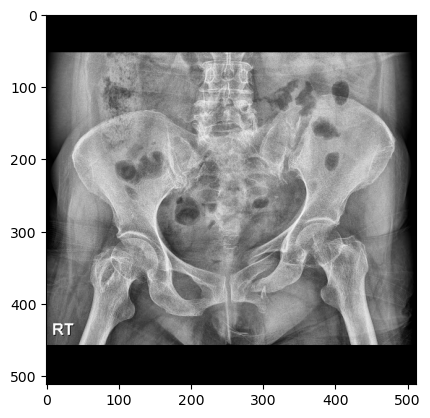

[278.05405405 368.86486486 309.62162162 409.08108108]
[278 368 309 409]
[273.2972973  324.75675676 328.64864865 348.97297297]
[273 324 328 348]
[324.75675676 116.75675676 371.02702703 230.48648649]
[324 116 371 230]
[292.75675676 211.45945946 320.         246.91891892]
[292 211 320 246]
result : 0, True : 2


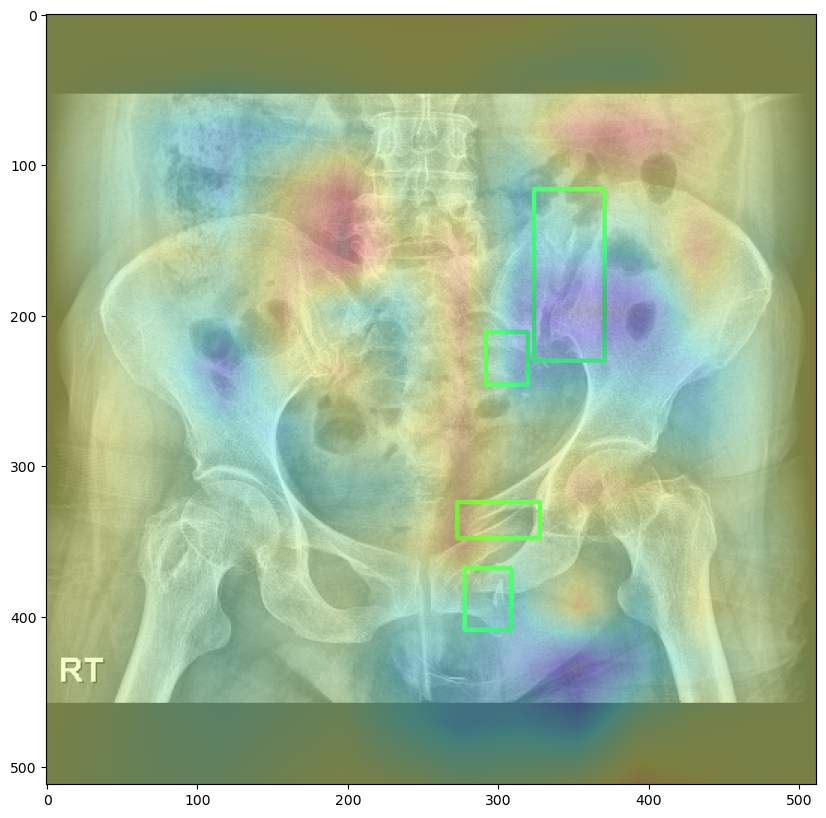

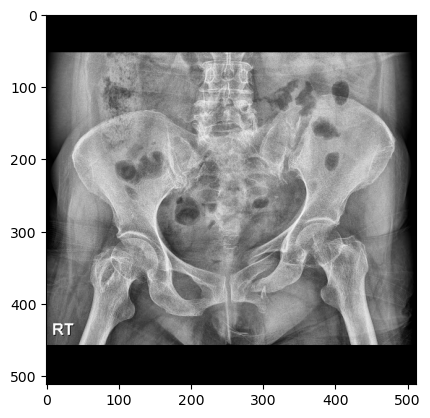

[278.05405405 368.86486486 309.62162162 409.08108108]
[278 368 309 409]
[273.2972973  324.75675676 328.64864865 348.97297297]
[273 324 328 348]
[324.75675676 116.75675676 371.02702703 230.48648649]
[324 116 371 230]
[292.75675676 211.45945946 320.         246.91891892]
[292 211 320 246]
result : 0, True : 2


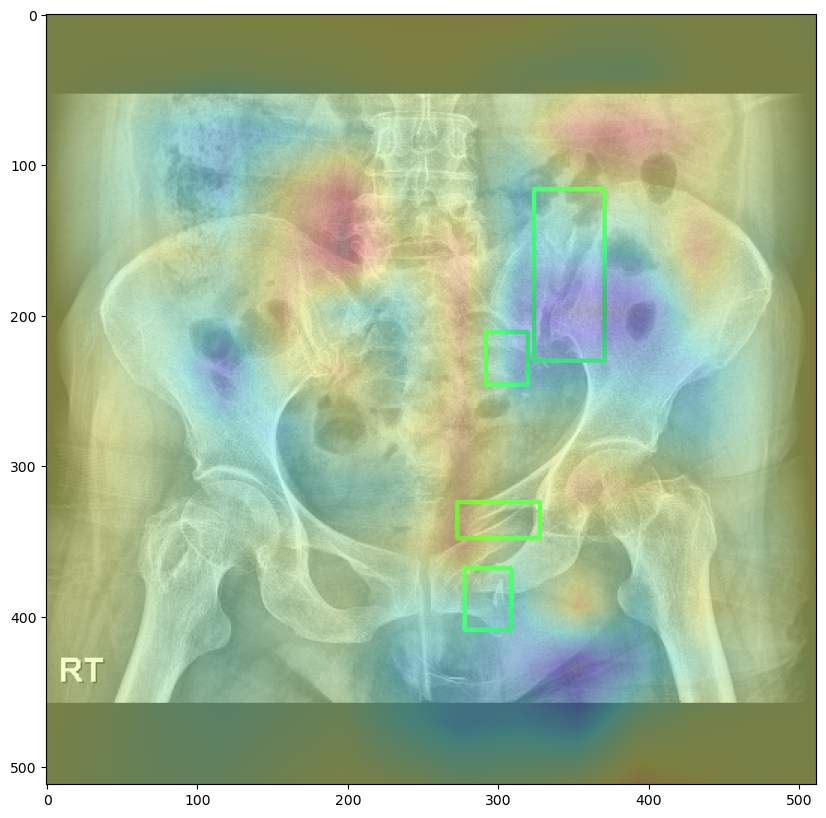

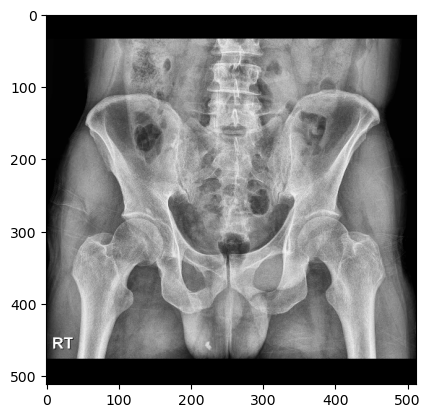

[189.13432836 384.63681592 222.24875622 410.74626866]
[189 384 222 410]
[280.8358209  379.54228856 320.95522388 400.55721393]
[280 379 320 400]
result : 0, True : 0


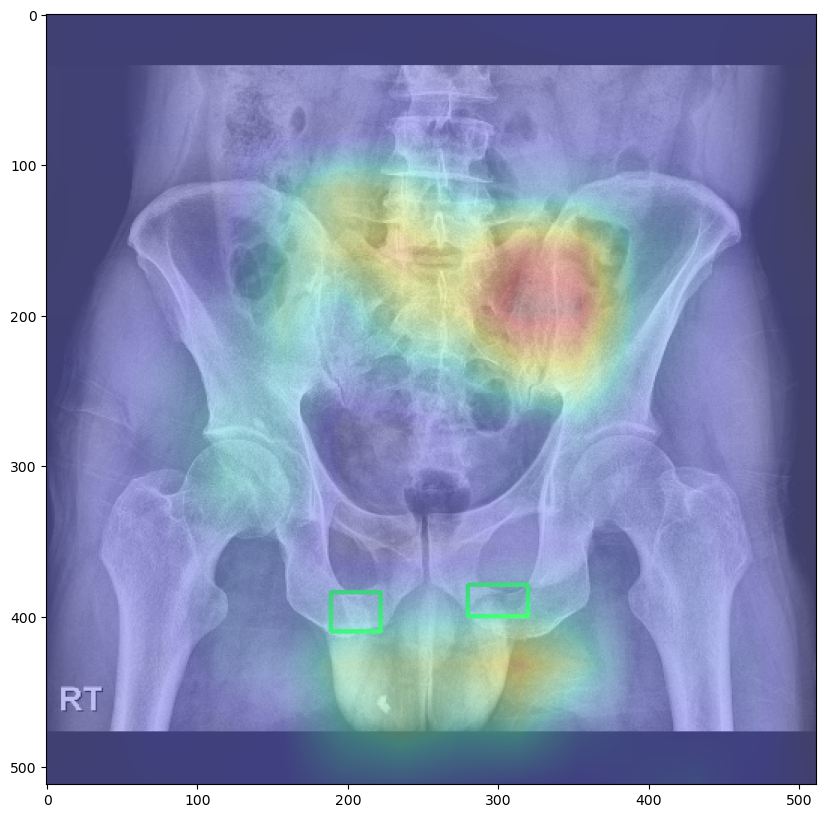

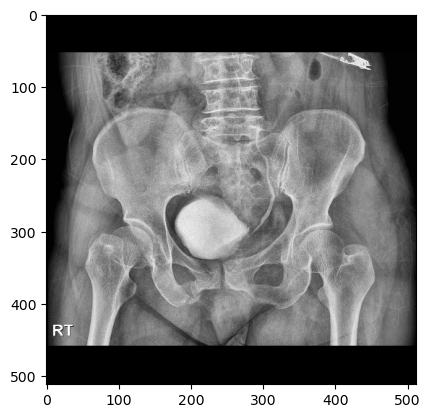

[168.97270471 365.04880066 218.52109181 402.52770885]
[168 365 218 402]
result : 0, True : 0


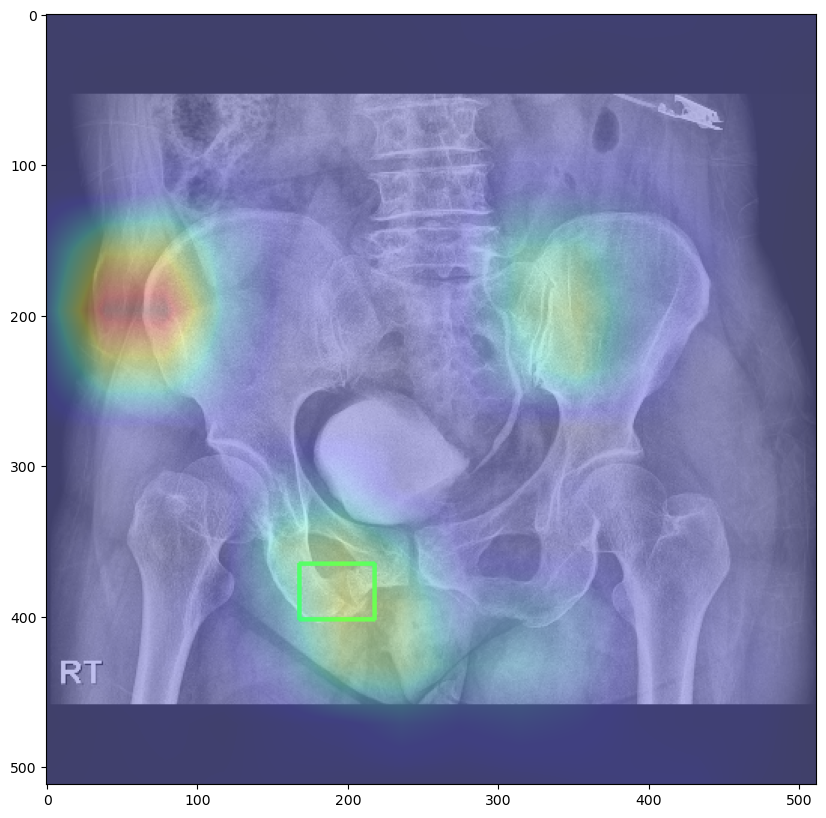

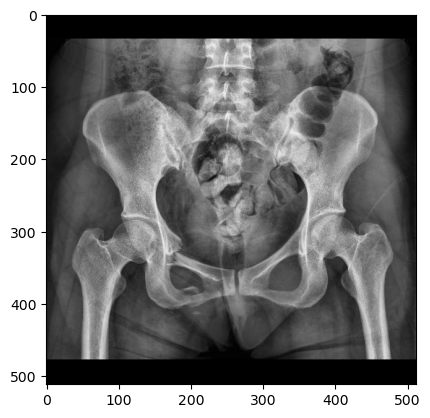

[165.24349158 305.20061256 191.1179173  348.12863706]
[165 305 191 348]
[175.24042879 374.59111792 221.69678407 416.93108729]
[175 374 221 416]
[189.35375191 127.60796325 225.22511485 187.58958652]
[189 127 225 187]
result : 0, True : 0


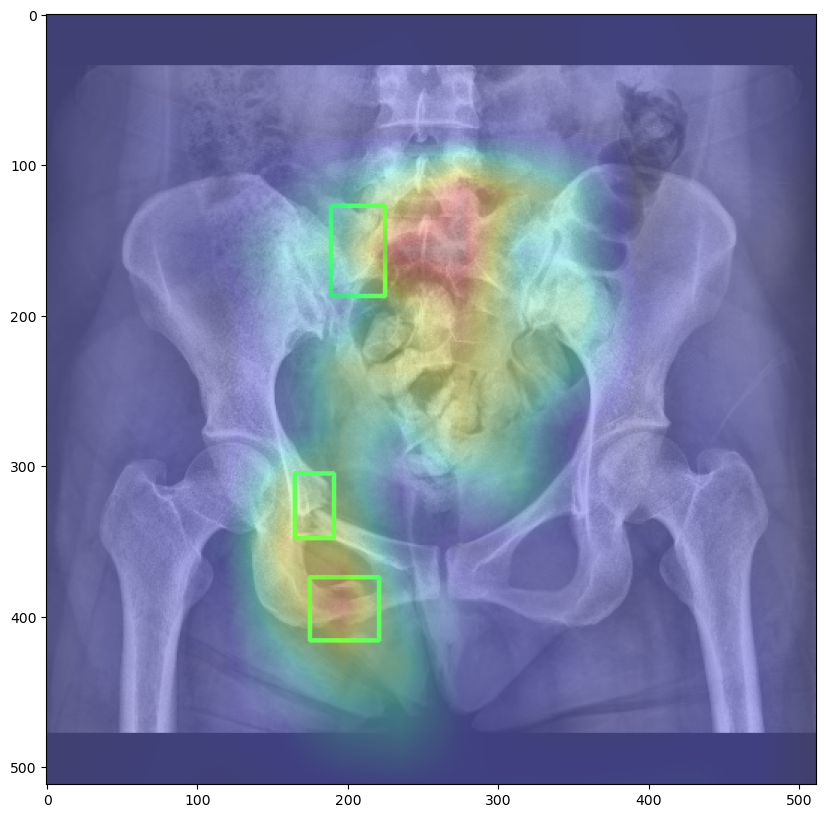

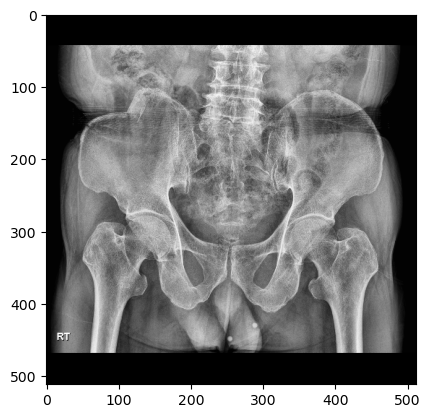

[ 52.61102362 132.83779528 118.52598425 175.77322835]
[ 52 132 118 175]
[118.52598425 100.78740157 169.32283465 161.25984252]
[118 100 169 161]
result : 0, True : 0


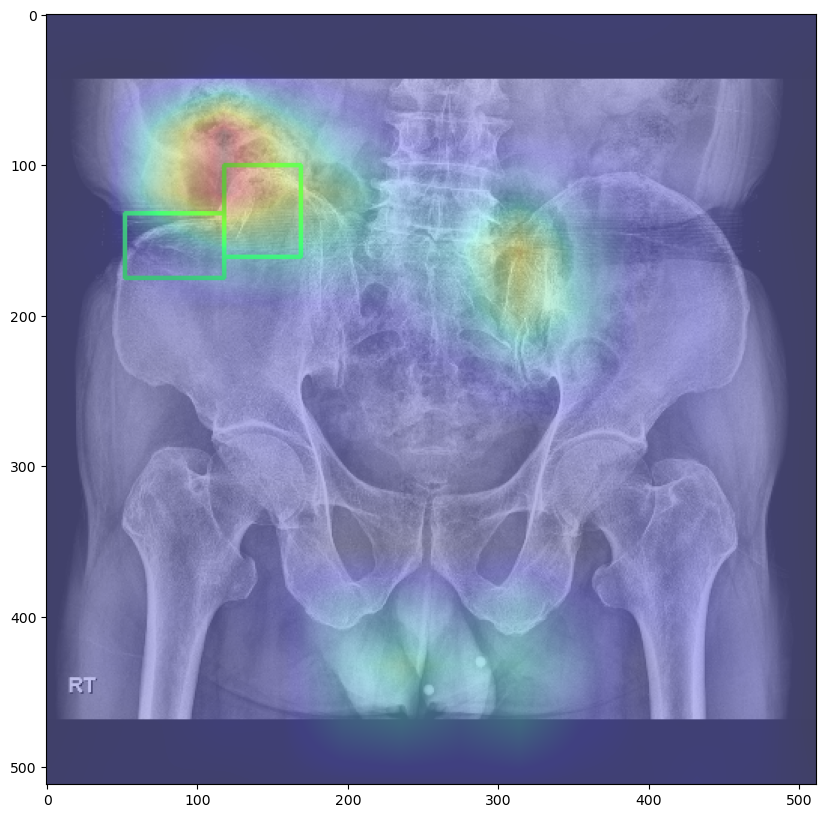

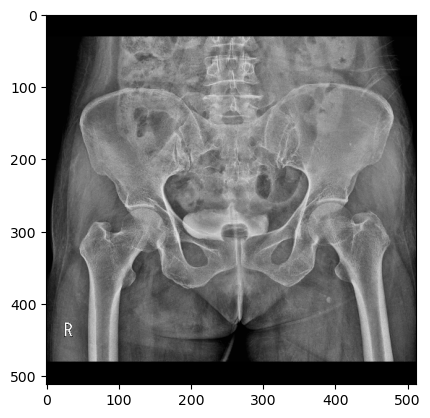

[317.64305949 341.21246459 361.69971671 367.86402266]
[317 341 361 367]
[330.1529745  272.67988669 360.61189802 291.17280453]
[330 272 360 291]
[314.3796034  126.9121813  340.48725212 204.69121813]
[314 126 340 204]
result : 1, True : 0


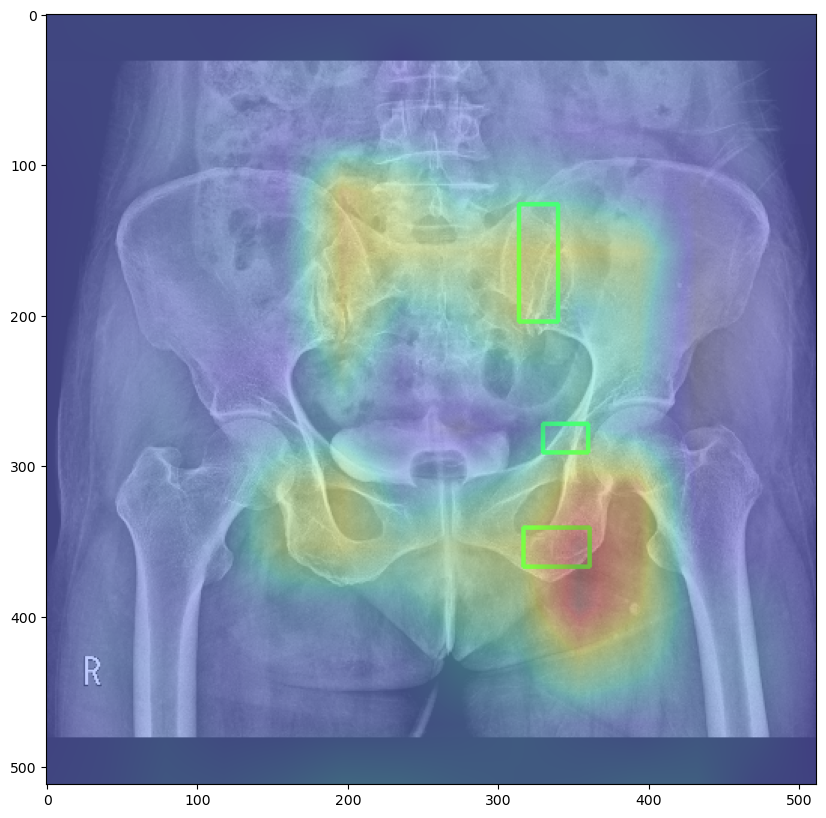

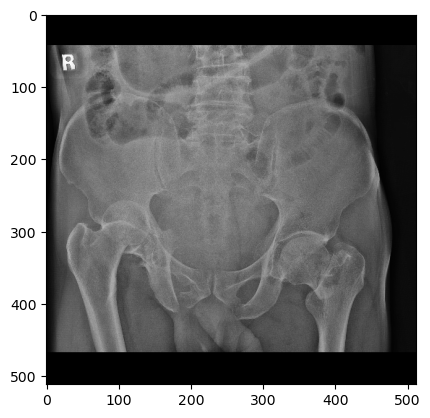

[167.176781   378.7651715  202.13192612 412.70712401]
[167 378 202 412]
[248.73878628 389.40369393 280.65435356 421.82585752]
[248 389 280 421]
[141.34036939 292.13720317 179.84168865 353.4353562 ]
[141 292 179 353]
[322.19525066 238.94459103 360.69656992 296.18997361]
[322 238 360 296]
[306.49076517 303.2823219  359.176781   336.7176781 ]
[306 303 359 336]
[299.39841689 146.23746702 323.20844327 256.67546174]
[299 146 323 256]
result : 1, True : 1


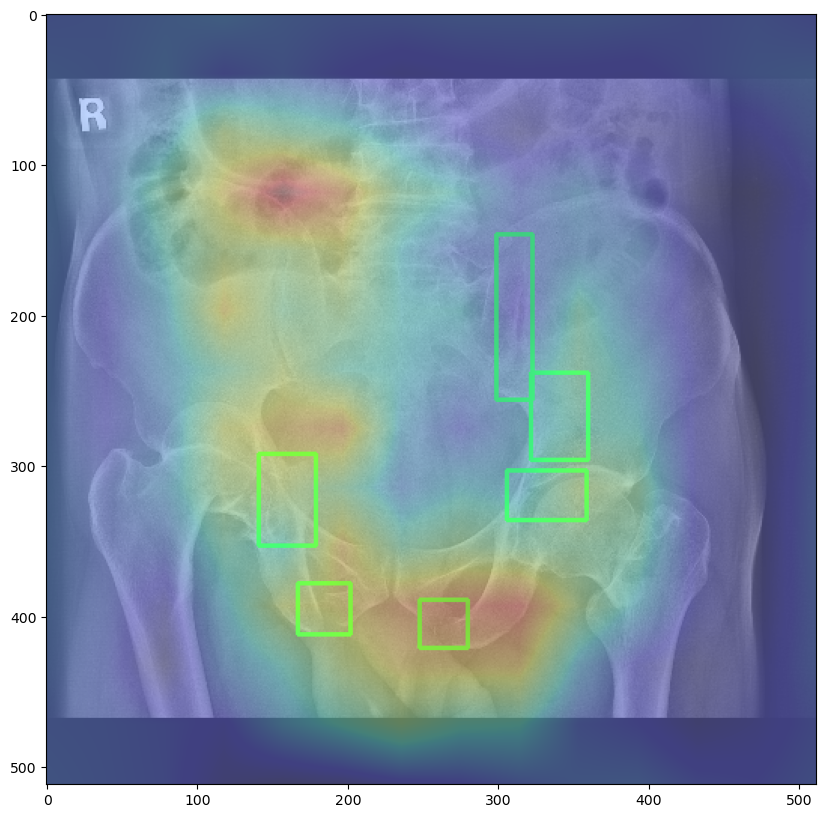

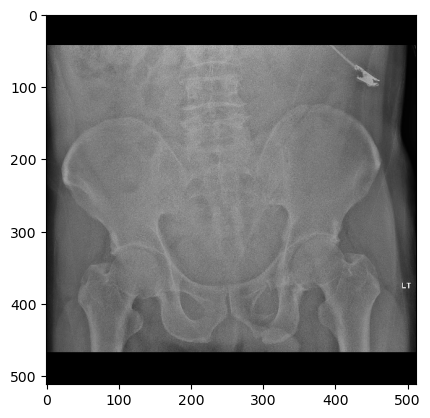

[305.98416887 322.02638522 333.8469657  375.21899736]
[305 322 333 375]
[268.49604222 378.7651715  298.89182058 416.75989446]
[268 378 298 416]
[279.13456464 418.78627968 325.7414248  455.76781003]
[279 418 325 455]
[291.7994723  123.44063325 376.90765172 271.36675462]
[291 123 376 271]
result : 1, True : 1


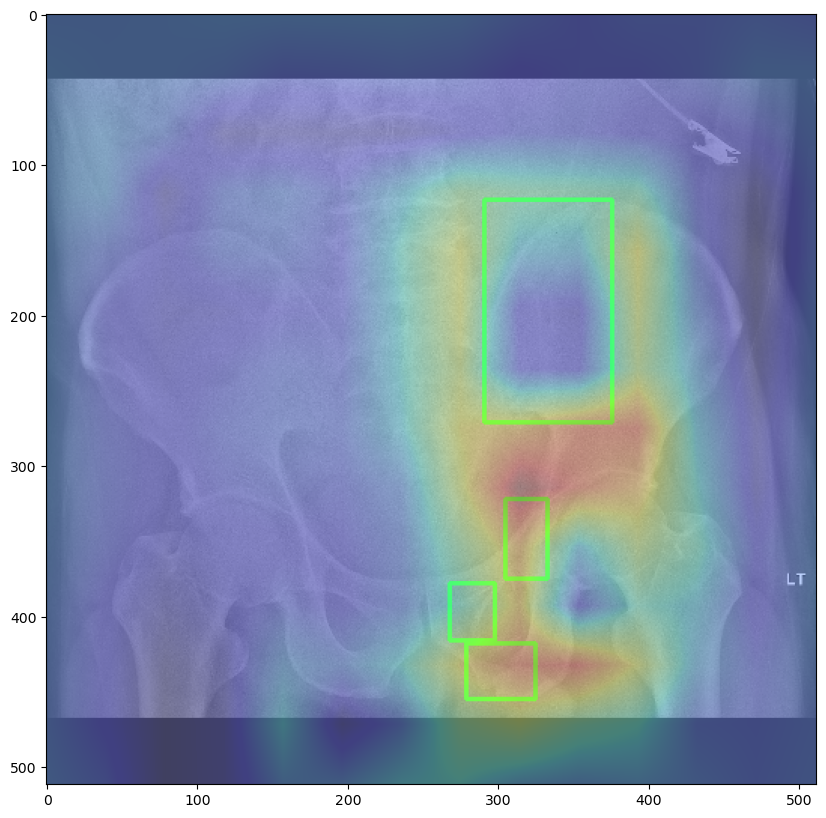

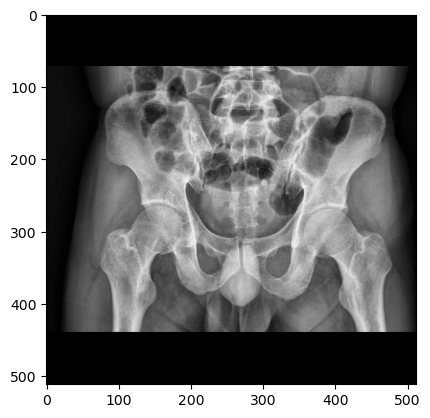

[196.32676056 269.52112676 220.12394366 307.92112676]
[196 269 220 307]
[222.28732394 184.6084507  236.89014085 229.49859155]
[222 184 236 229]
[219.58309859 350.10704225 259.06478873 383.09859155]
[219 350 259 383]
[243.38028169 305.75774648 265.55492958 332.25915493]
[243 305 265 332]
result : 0, True : 0


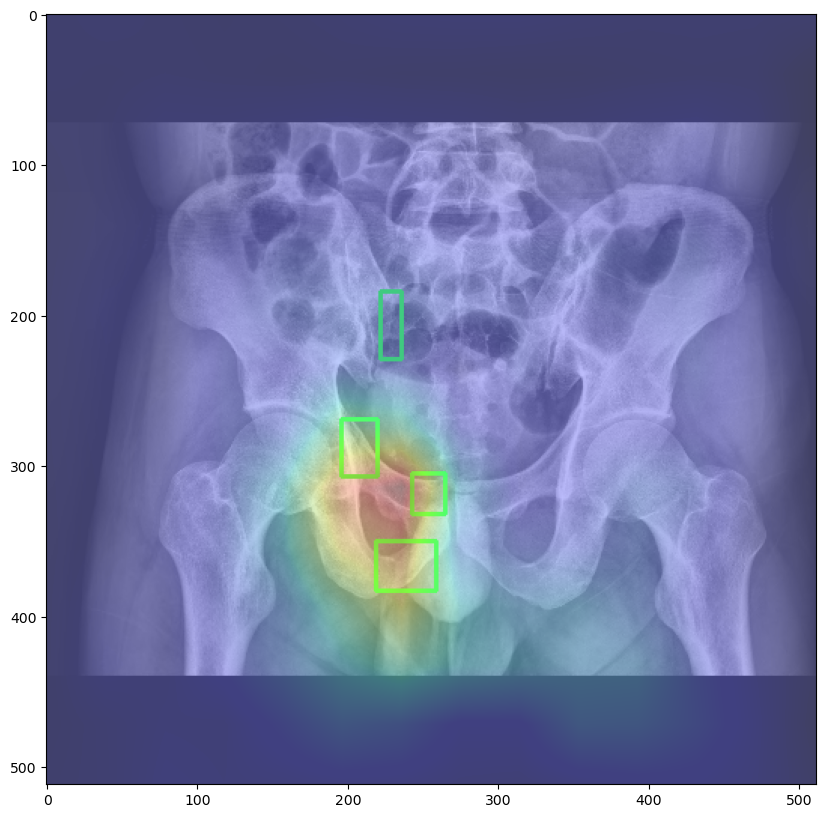

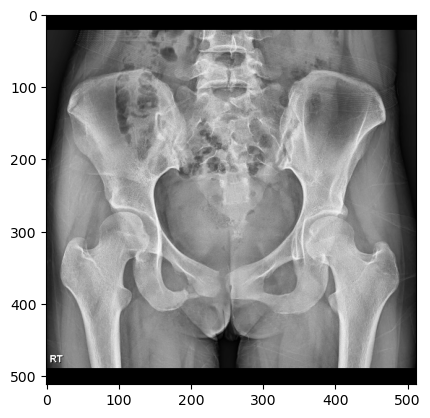

[184.34691196 370.48795445 213.9500657  400.76390714]
[184 370 213 400]
[149.36136662 294.46167324 165.50854139 311.9544459 ]
[149 294 165 311]
result : 1, True : 0


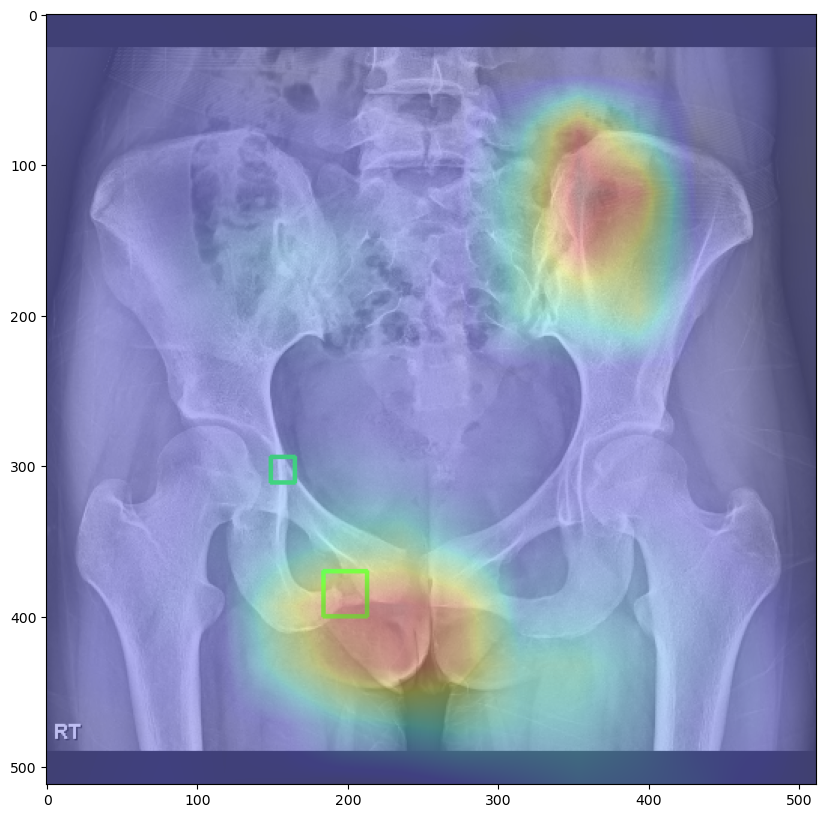

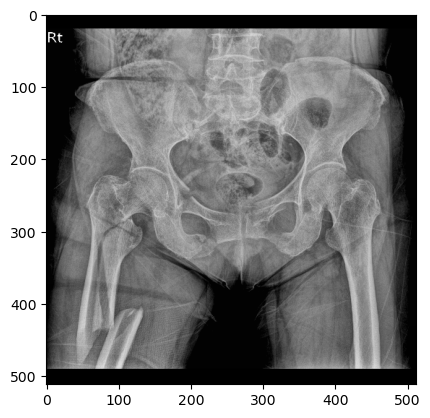

[175.63343653 237.6123839  200.99566563 272.48544892]
[175 237 200 272]
[199.72755418 302.92012384 236.50278638 333.98885449]
[199 302 236 333]
[303.7126935  299.11578947 336.0495356  323.84396285]
[303 299 336 323]
[278.98452012 255.36594427 326.53869969 294.04334365]
[278 255 326 294]
[197.825387   110.80123839 222.55356037 178.64520124]
[197 110 222 178]
result : 2, True : 0


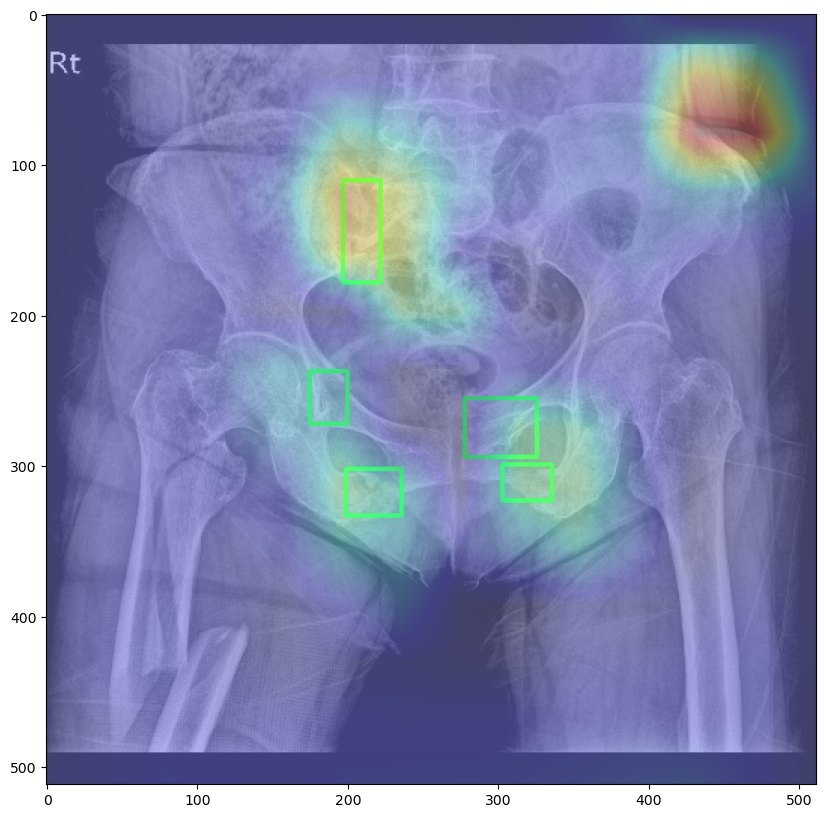

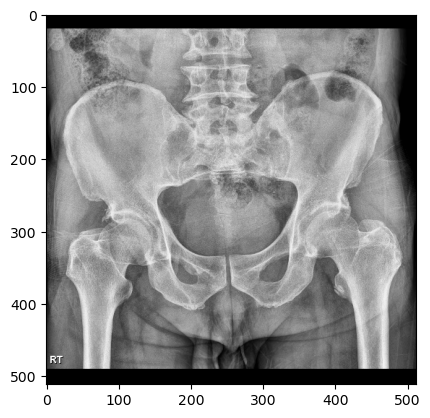

[150.3262288  277.49108308 178.38712484 318.91431057]
[150 277 178 318]
[187.74075685 367.68682036 213.79730318 410.44628099]
[187 367 213 410]
result : 2, True : 0


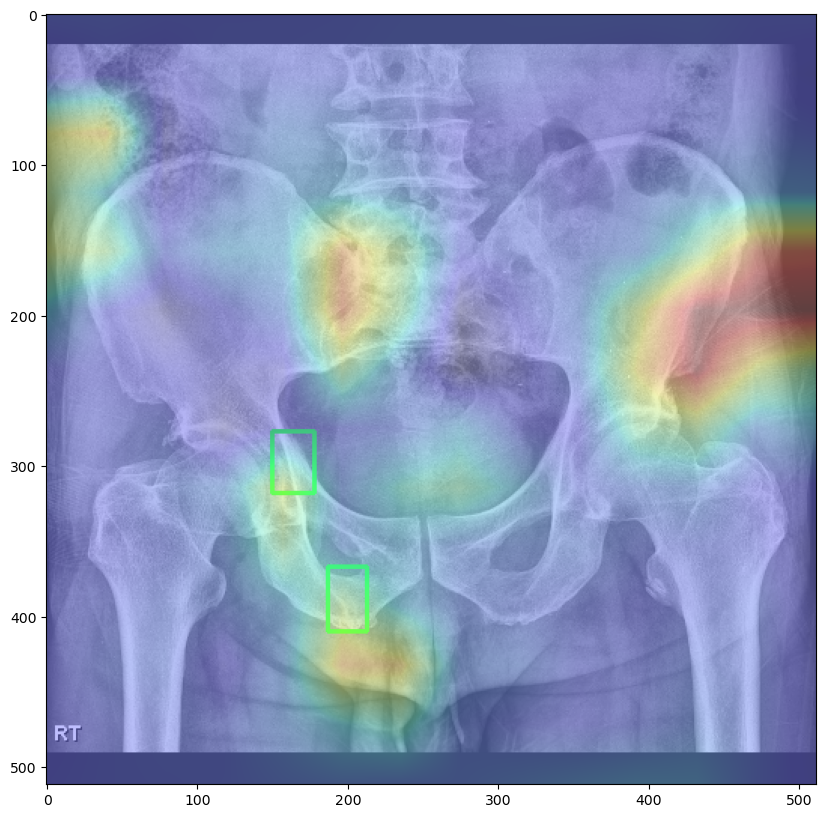

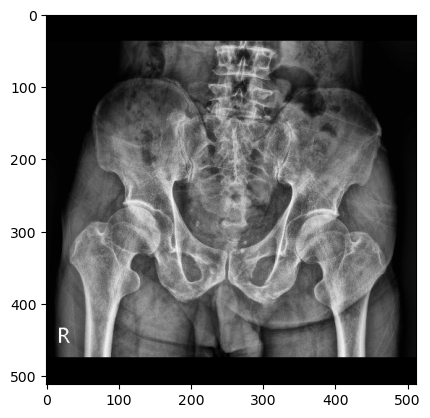

[287.02080783 367.23623011 318.98164015 404.21052632]
[287 367 318 404]
[261.32680539 327.12851897 288.27417381 367.23623011]
[261 327 288 367]
result : 0, True : 0


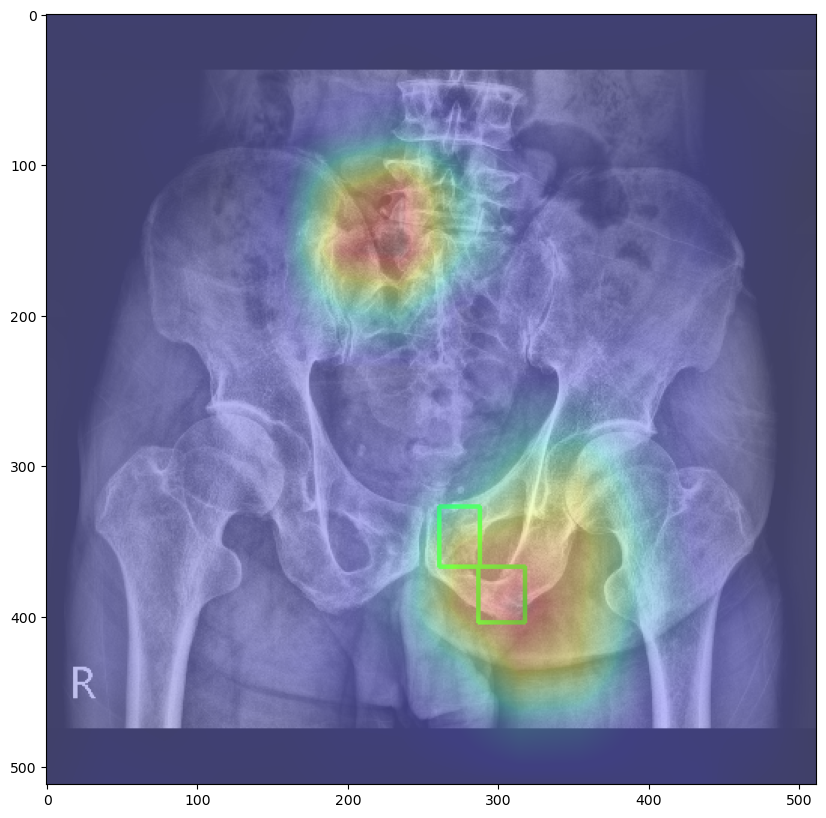

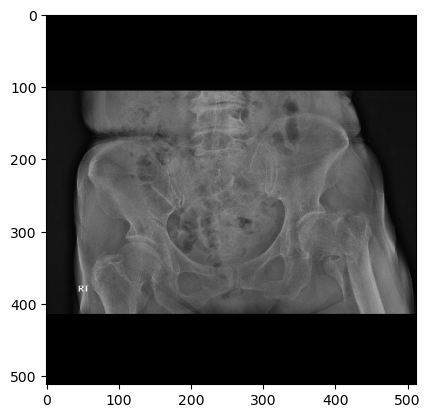

[291.17040951 363.37120211 330.73712021 393.80713342]
[291 363 330 393]
result : 0, True : 0


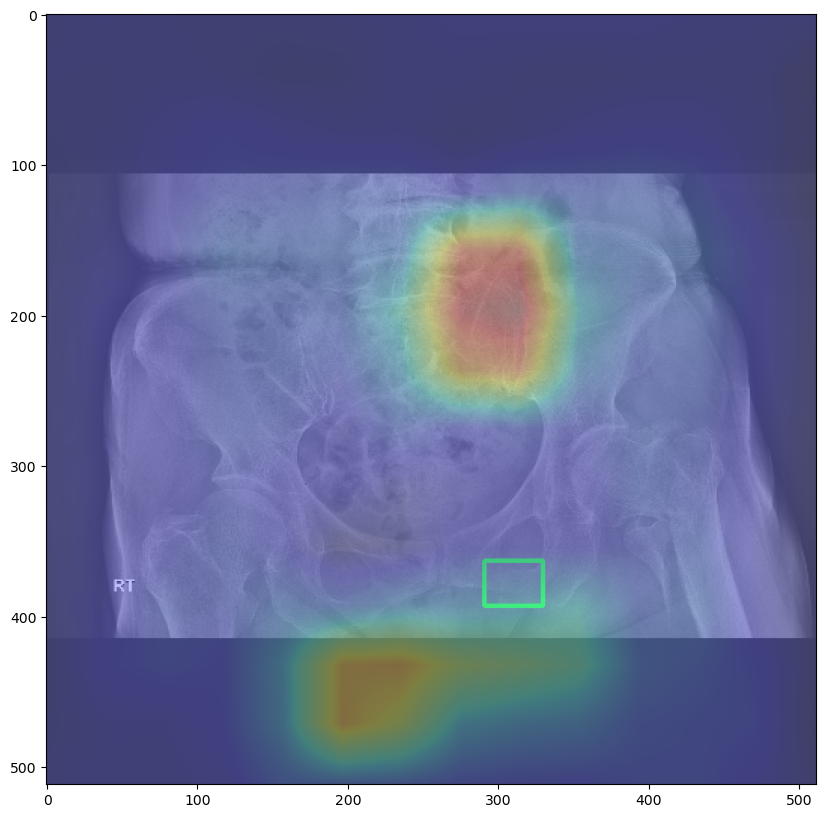

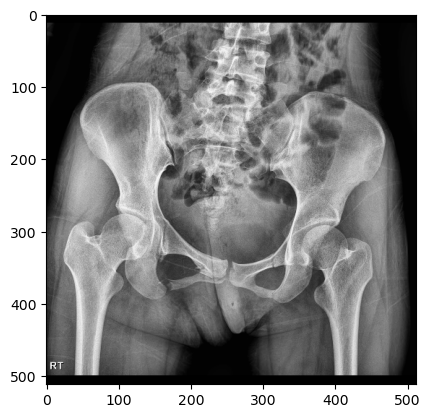

[146.94584838 279.79783394 176.75090253 333.86281588]
[146 279 176 333]
[153.87725632 358.81588448 183.68231047 390.00722022]
[153 358 183 390]
[299.4368231  322.07942238 320.92418773 353.96389892]
[299 322 320 353]
[211.40794224 344.2599278  248.14440433 371.29241877]
[211 344 248 371]
[273.79061372 137.01083032 308.44765343 198.00722022]
[273 137 308 198]
[194.07942238 143.24909747 219.03249097 203.55234657]
[194 143 219 203]
[300.1299639  373.37184116 323.6967509  394.85920578]
[300 373 323 394]
result : 0, True : 0


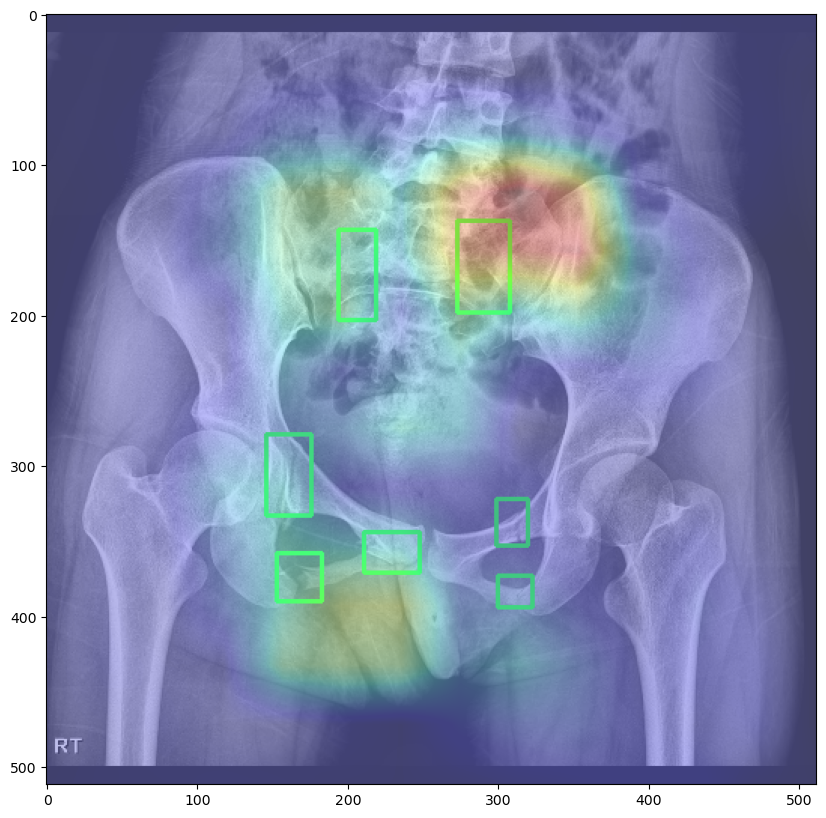

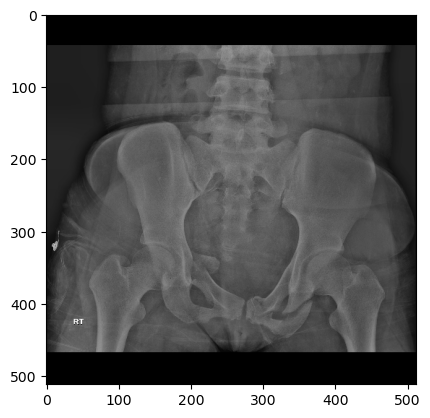

[286.22691293 388.89709763 312.56992084 425.87862797]
[286 388 312 425]
[326.75461741 387.88390501 371.33509235 422.33245383]
[326 387 371 422]
[195.03957784 330.13192612 222.39577836 378.2585752 ]
[195 330 222 378]
[193.01319261 402.06860158 219.35620053 429.42480211]
[193 402 219 429]
result : 0, True : 0


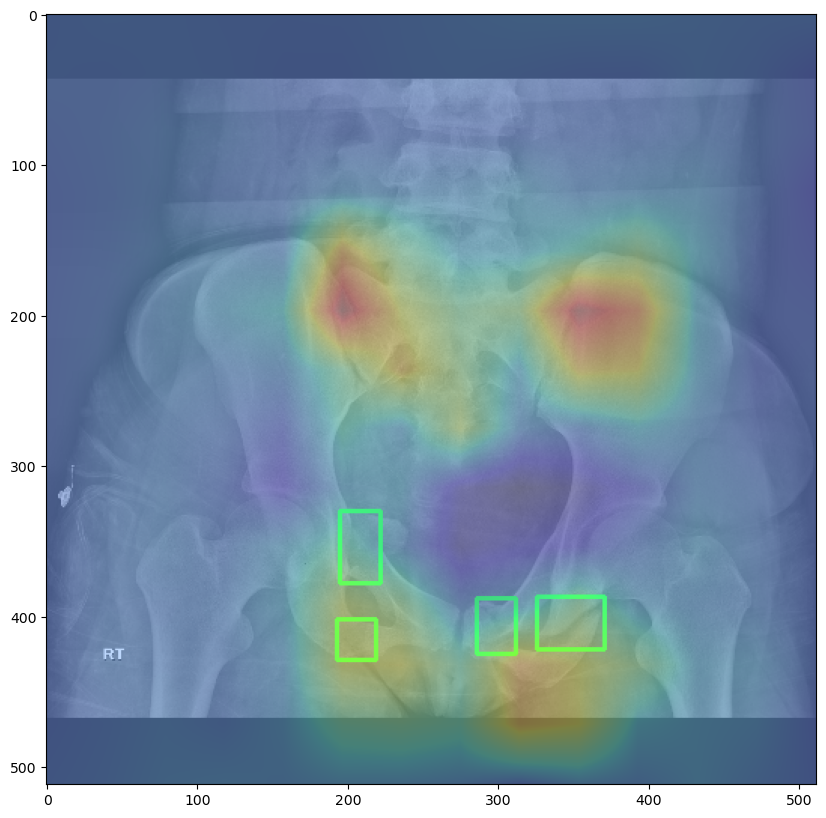

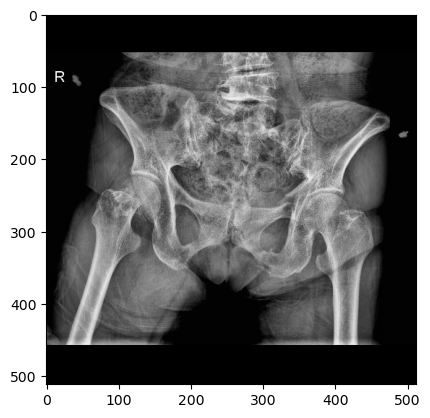

[318.96774194 244.30107527 347.35483871 277.33333333]
[318 244 347 277]
[291.61290323 318.62365591 317.93548387 357.33333333]
[291 318 317 357]
[193.5483871  315.52688172 212.64516129 338.23655914]
[193 315 212 338]
[226.06451613 118.88172043 251.35483871 191.13978495]
[226 118 251 191]
result : 2, True : 0


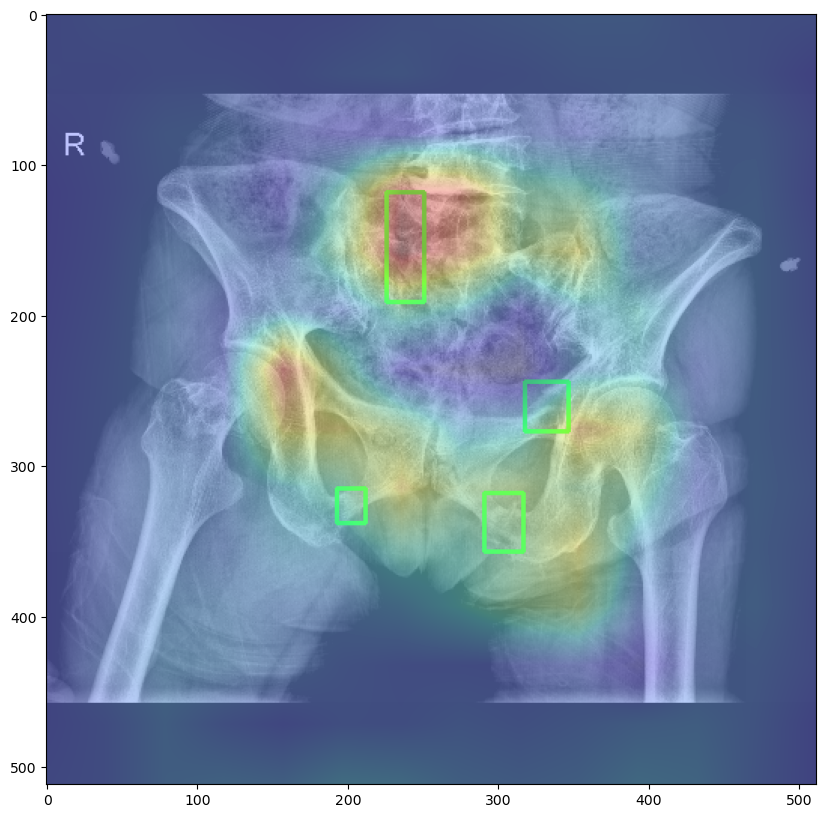

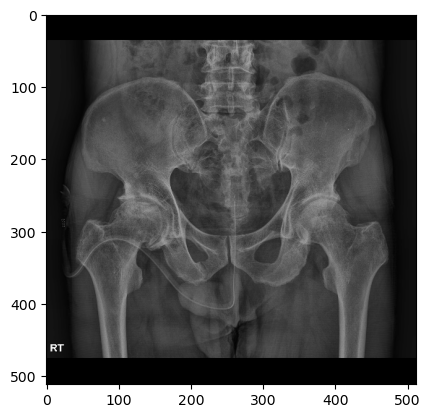

[196.13826759 338.55713705 232.36762912 373.53721025]
[196 338 232 373]
[169.27856852 256.72875153 192.3904026  293.58275722]
[169 256 192 293]
result : 0, True : 0


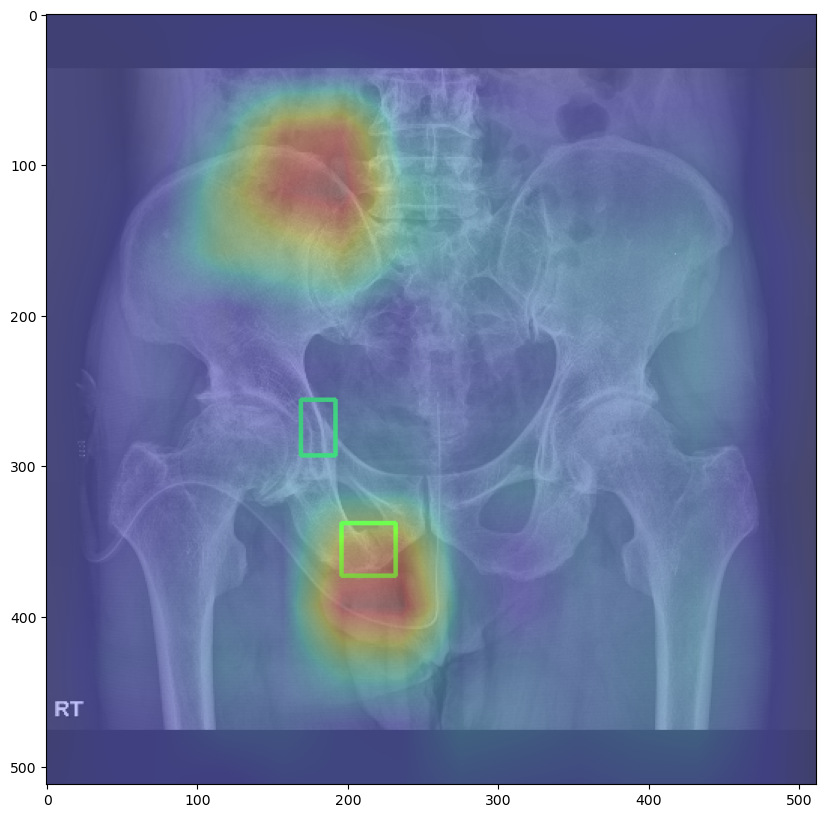

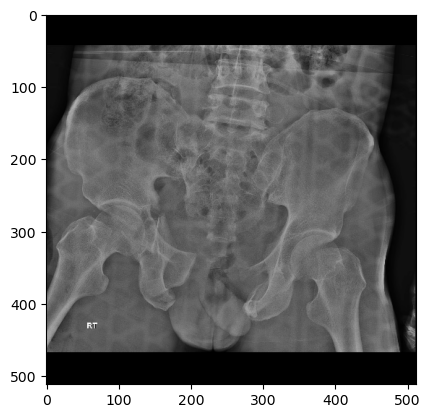

[144.88654354 109.25593668 198.07915567 239.45118734]
[144 109 198 239]
[310.54353562 157.88918206 338.91292876 266.30079156]
[310 157 338 266]
[135.26121372 264.27440633 166.16358839 330.13192612]
[135 264 166 330]
[197.57255937 330.63852243 287.24010554 402.57519789]
[197 330 287 402]
[156.53825858 363.56728232 179.33509235 411.18733509]
[156 363 179 411]
result : 2, True : 2


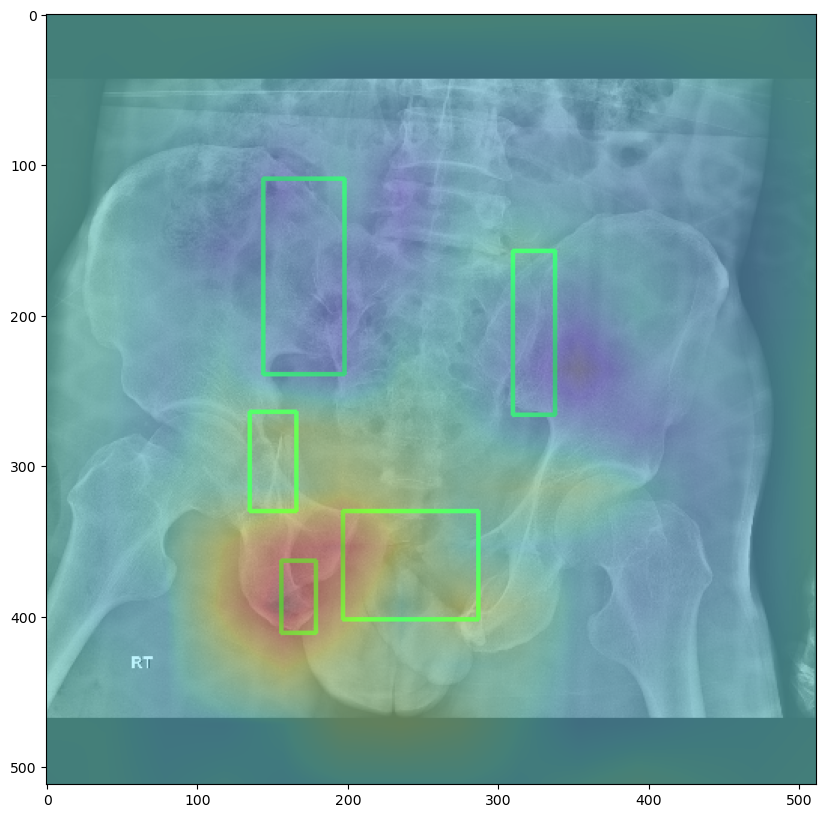

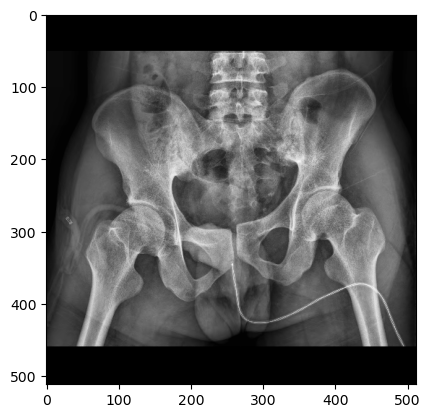

[184.38893044 287.40164547 210.81226627 314.39940165]
[184 287 210 314]
[265.9566193  286.82722513 305.01720269 315.54824233]
[265 286 305 315]
[302.14510097 143.79655946 333.16379955 220.76888556]
[302 143 333 220]
result : 0, True : 1


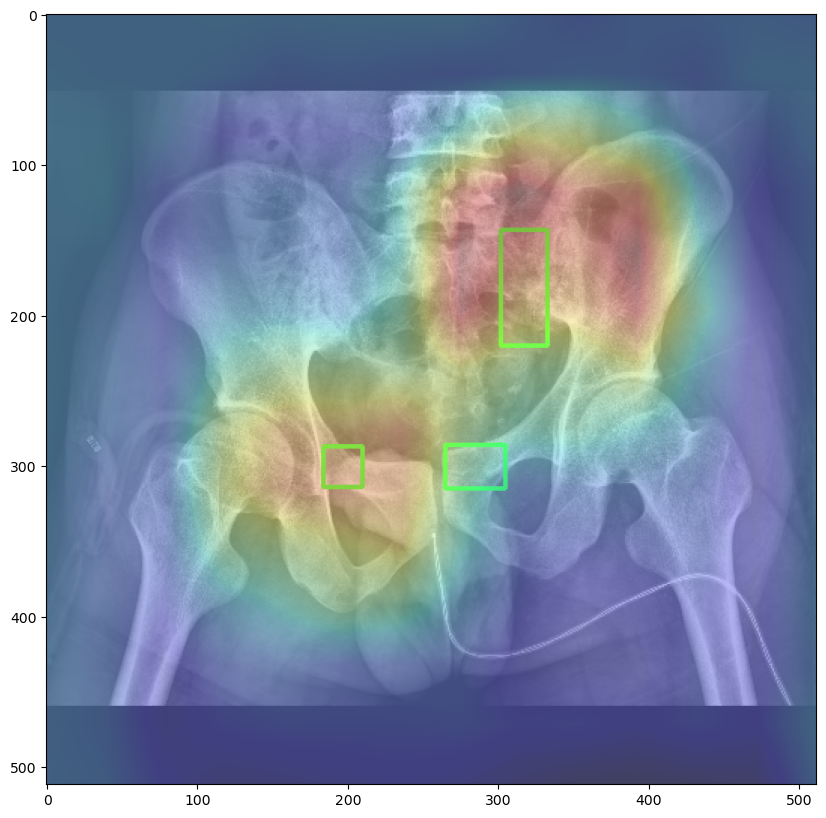

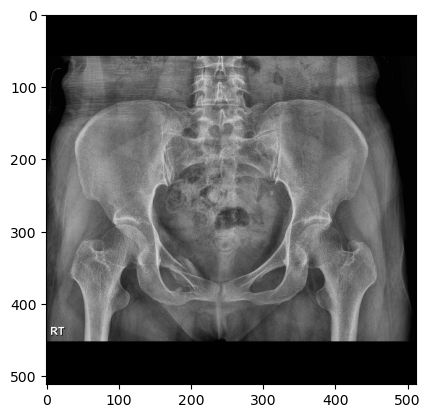

[167.93944491 338.24726661 202.17325484 370.54331371]
[167 338 202 370]
[175.04457527 382.16989066 204.7569386  402.19343987]
[175 382 204 402]
result : 0, True : 0


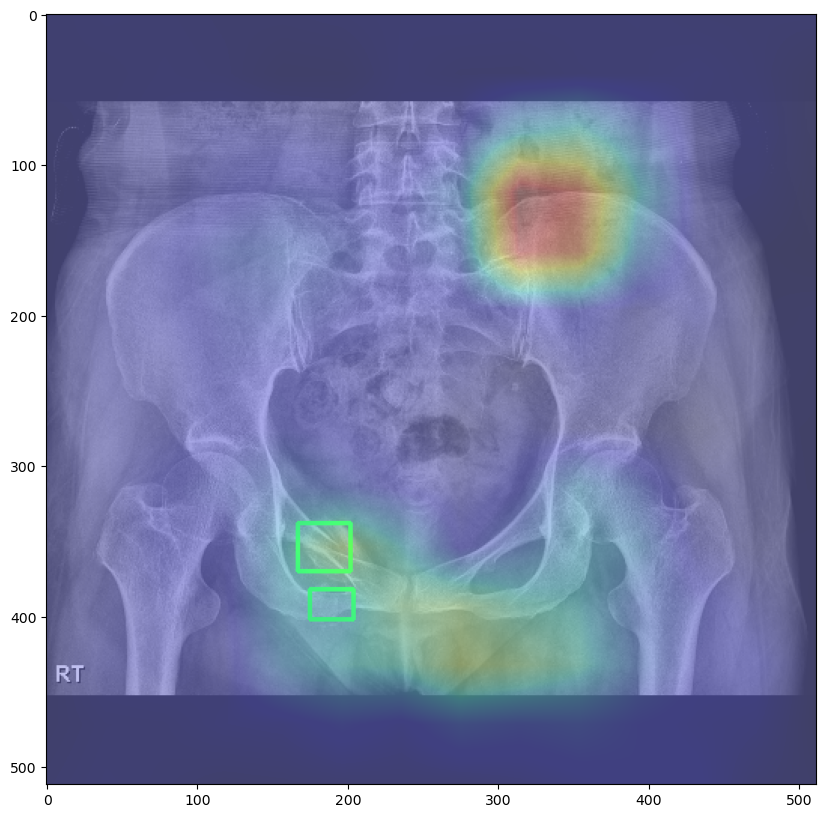

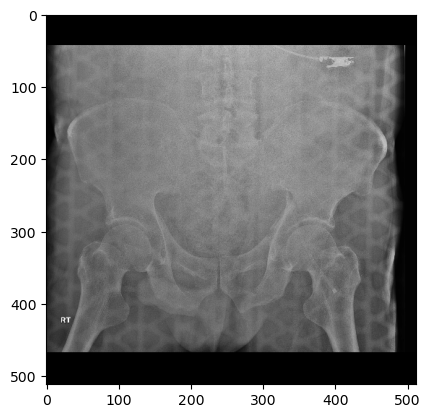

[302.60686016 285.88918206 335.70448549 324.39050132]
[302 285 335 324]
[291.7994723  159.57783641 322.19525066 238.60686016]
[291 159 322 238]
[277.61477573 374.37467018 312.73878628 400.04221636]
[277 374 312 400]
[243.16622691 333.17150396 278.29023747 365.59366755]
[243 333 278 365]
[170.89182058 326.41688654 230.33245383 363.56728232]
[170 326 230 363]
result : 2, True : 0


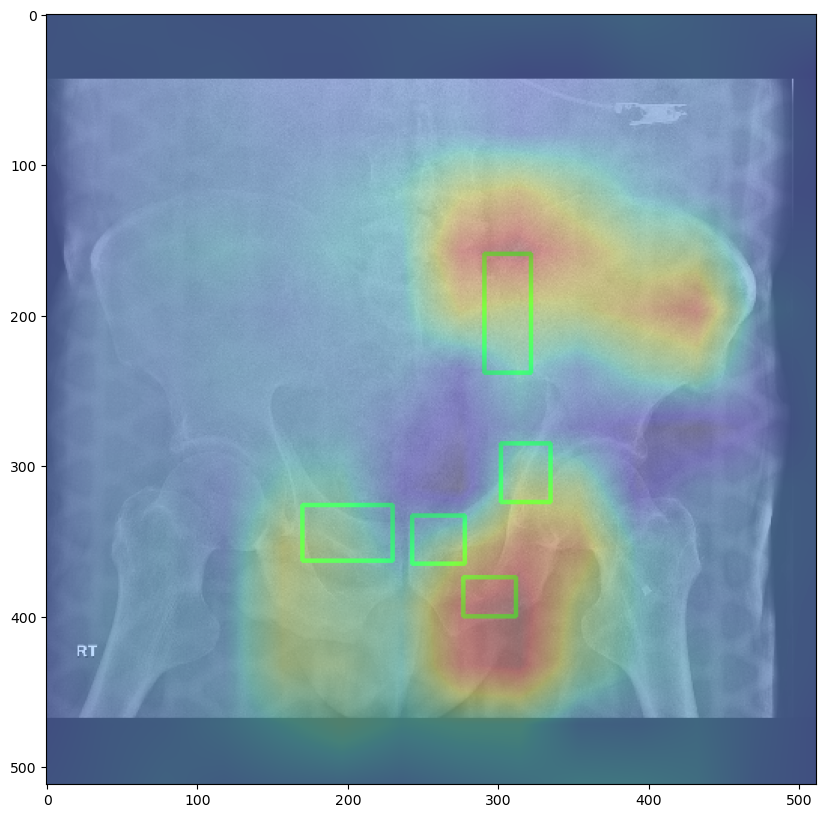

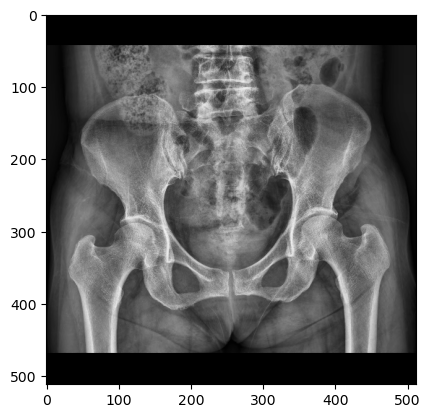

[319.80547112 299.76899696 347.23404255 348.79027356]
[319 299 347 348]
[302.29787234 146.86930091 329.14285714 204.6443769 ]
[302 146 329 204]
result : 0, True : 0


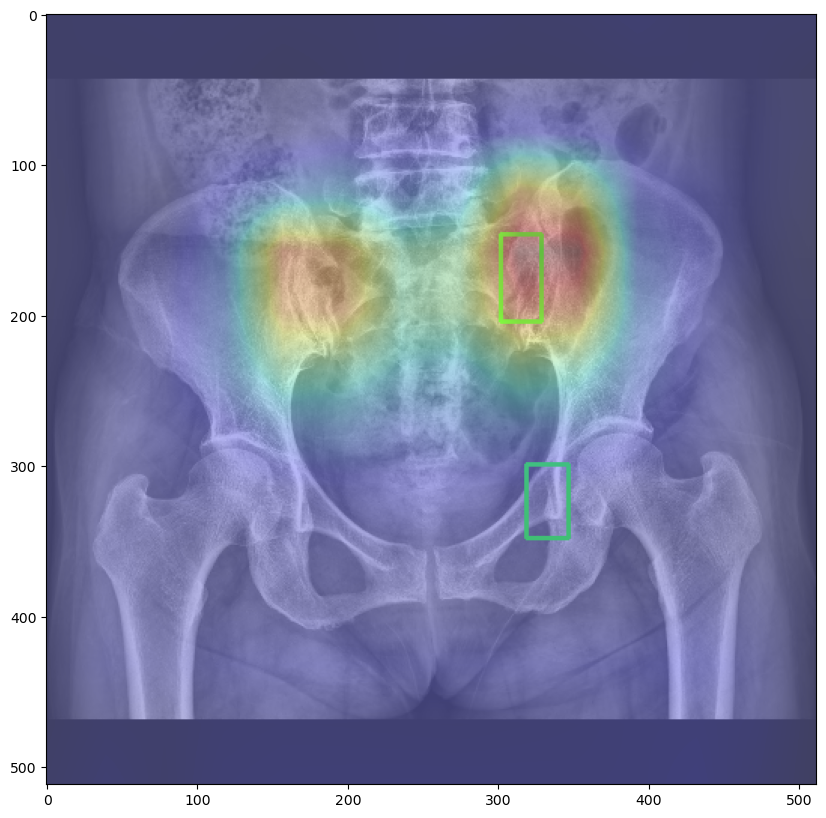

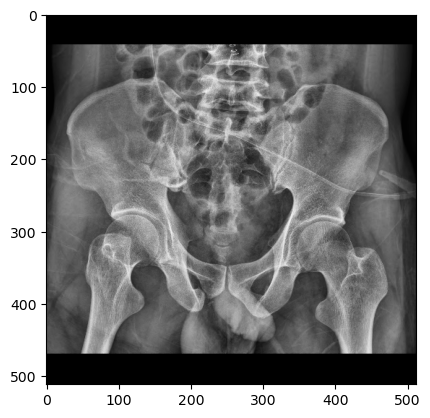

[204.63261136 369.51042092 227.85778504 402.77891295]
[204 369 227 402]
[164.45933796 294.18553331 194.58929301 343.77441765]
[164 294 194 343]
[129.93543114 172.41029832 192.07846342 228.90396404]
[129 172 192 228]
result : 0, True : 0


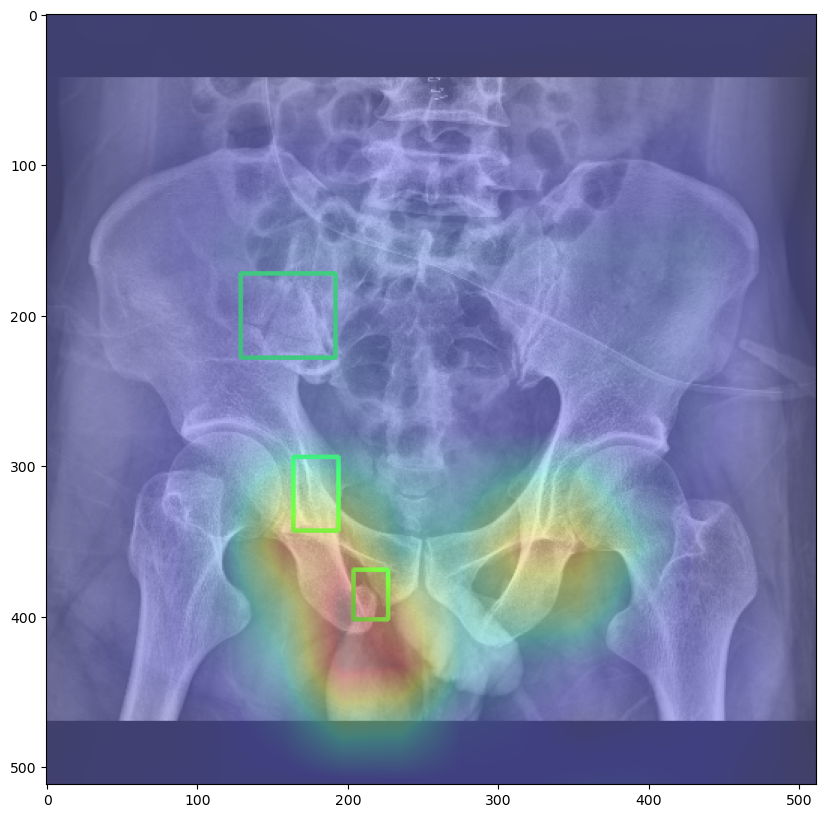

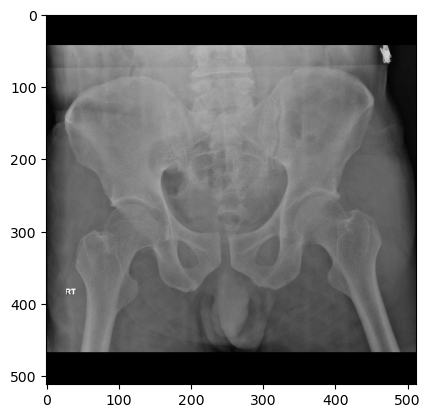

[237.59366755 304.80211082 258.8707124  348.87598945]
[237 304 258 348]
[207.70448549 140.15831135 238.60686016 190.81794195]
[207 140 238 190]
result : 3, True : 1


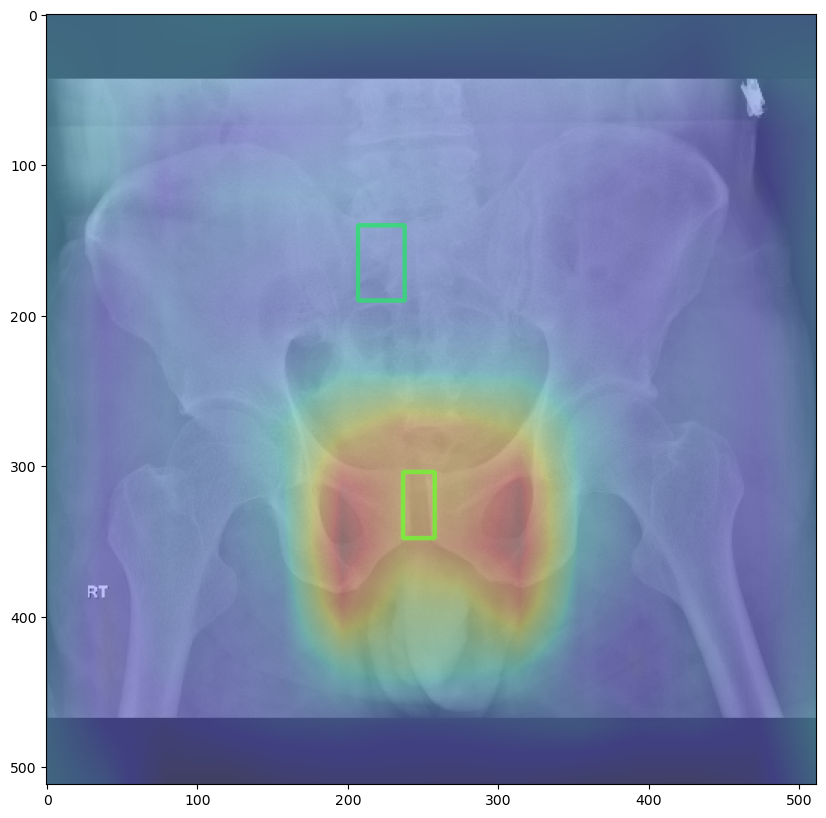

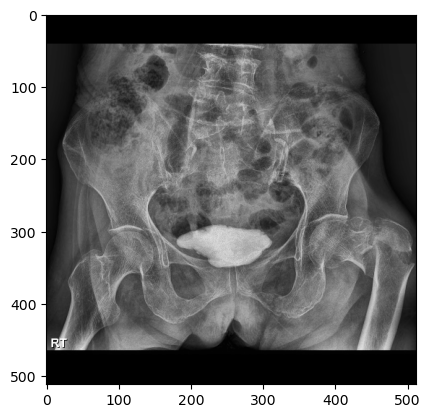

[301.48960302 381.58034026 328.58979206 415.45557656]
[301 381 328 415]
[295.68241966 324.47637051 320.36294896 346.73724008]
[295 324 320 346]
[180.9905482  388.83931947 202.76748582 420.77882798]
[180 388 202 420]
result : 0, True : 0


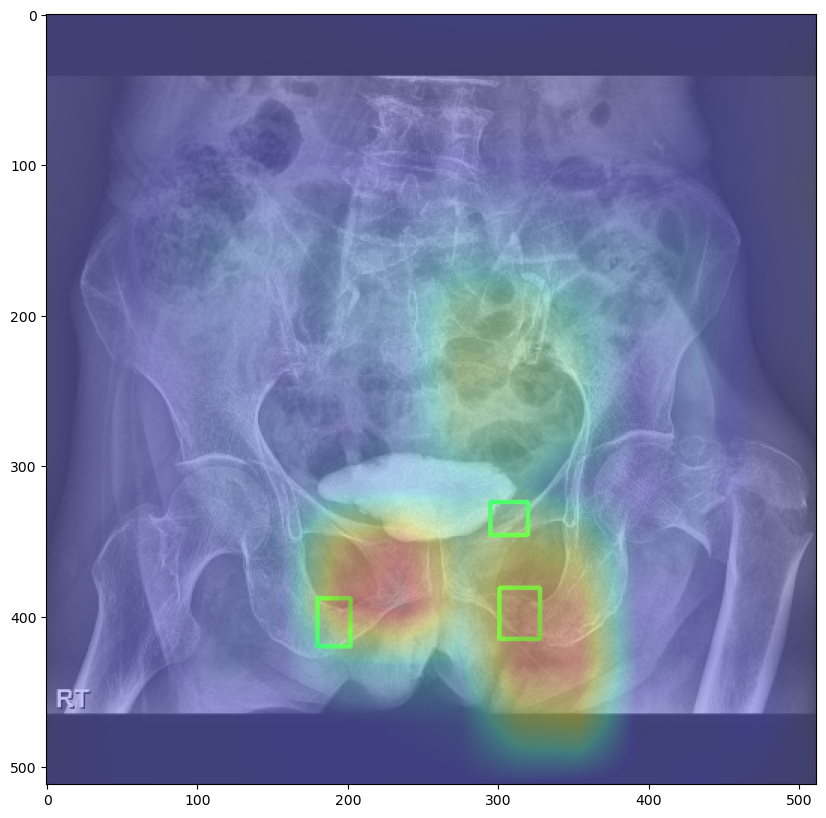

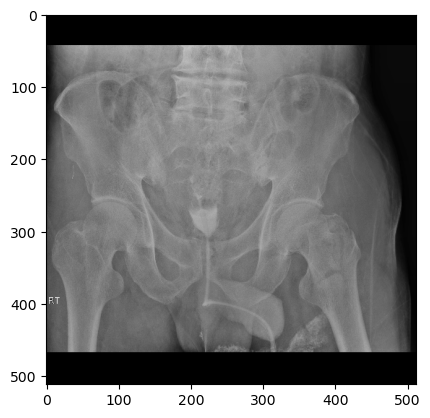

[299.90501319 250.59630607 322.70184697 292.64379947]
[299 250 322 292]
[168.18997361 363.56728232 188.96042216 394.46965699]
[168 363 188 394]
[253.80474934 369.64643799 271.53562005 399.02902375]
[253 369 271 399]
[282.17414248 131.03957784 322.19525066 225.26649077]
[282 131 322 225]
result : 0, True : 0


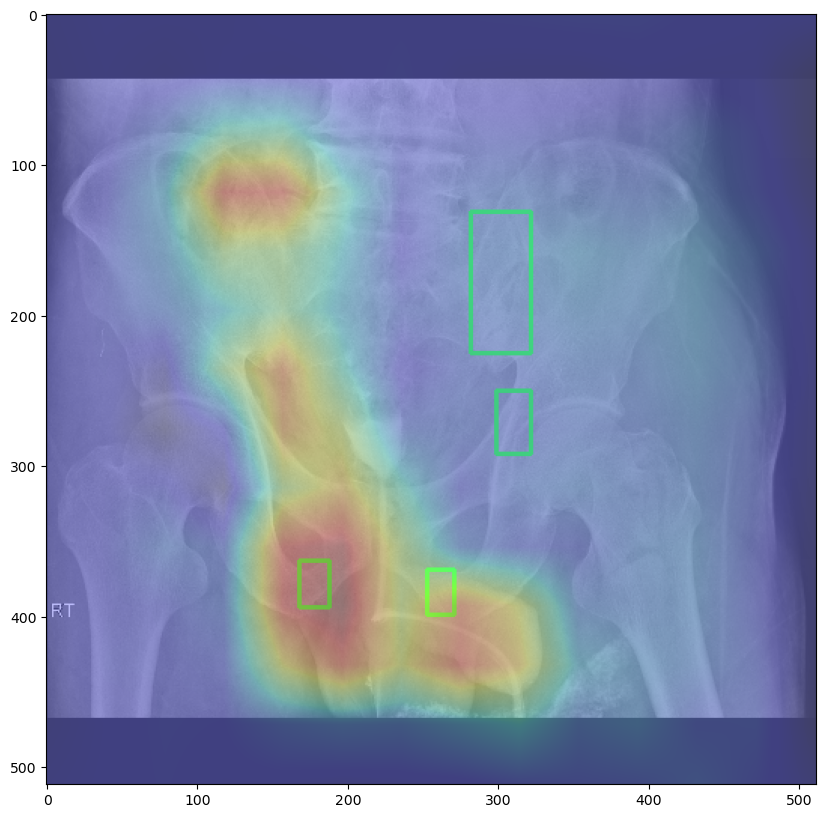

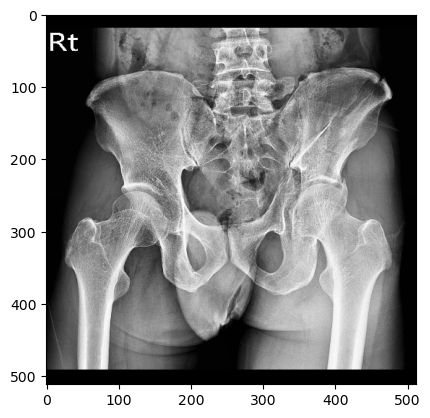

[324.67862069 214.15724138 353.28       297.84275862]
[324 214 353 297]
[402.53793103  82.27310345 464.50758621 143.71310345]
[402  82 464 143]
[351.69103448 154.3062069  395.65241379 197.20827586]
[351 154 395 197]
[398.83034483 219.98344828 417.89793103 244.34758621]
[398 219 417 244]
[299.78482759 260.23724138 321.50068966 303.66896552]
[299 260 321 303]
result : 1, True : 1


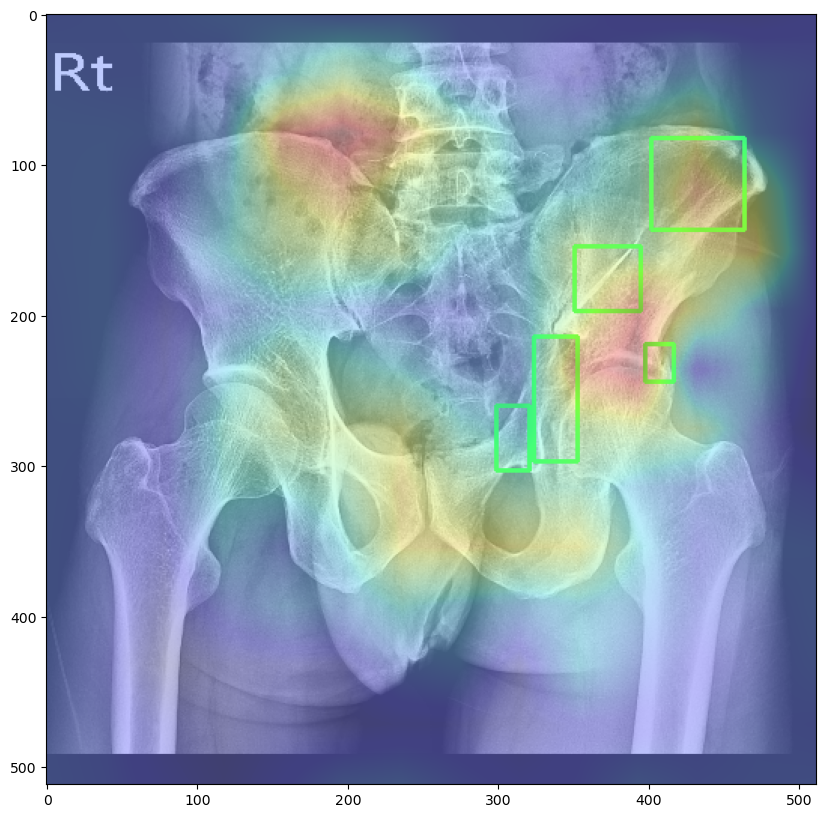

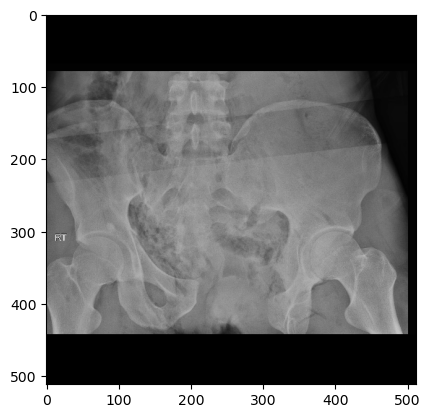

[104.65519615 161.38747419 146.41156228 269.21403992]
[104 161 146 269]
[208.7818307  370.69786648 311.32278045 423.55402615]
[208 370 311 423]
[270.09497591 157.68754301 312.37990365 280.84239504]
[270 157 312 280]
[372.10736407 264.45698555 402.76393668 305.15622849]
[372 264 402 305]
[100.95526497 295.64211975 133.19752237 327.35581555]
[100 295 133 327]
[147.99724708 401.88300069 168.08258775 434.12525809]
[147 401 168 434]
[331.40812113 417.73984859 348.32209222 440.99655884]
[331 417 348 440]
result : 0, True : 2


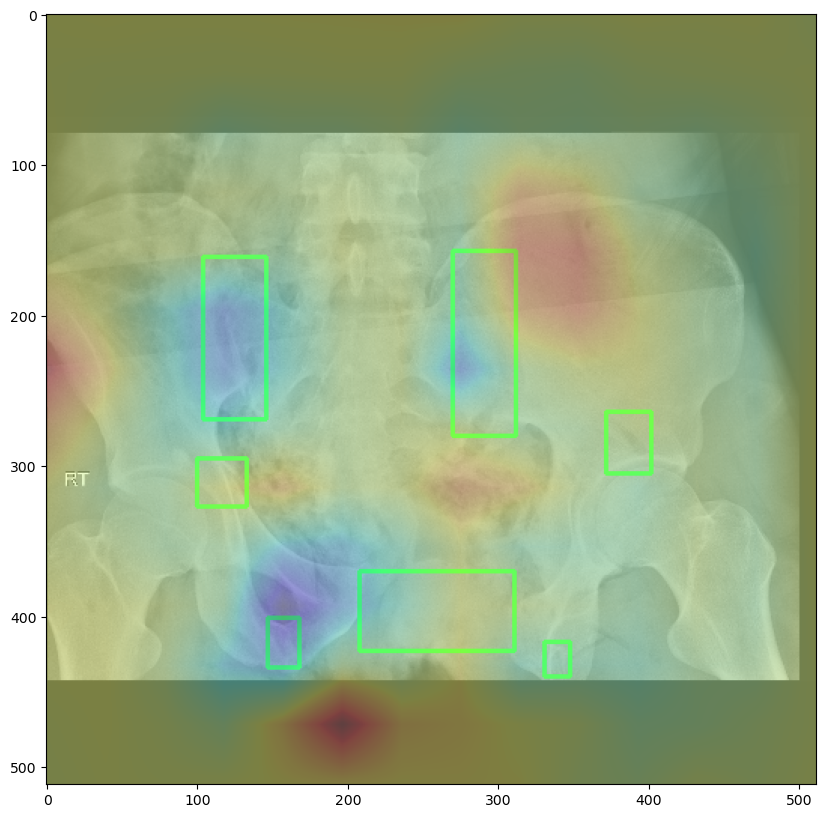

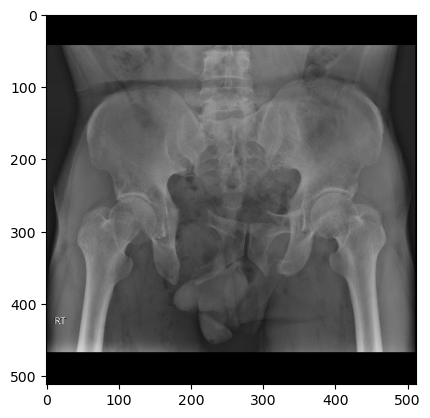

[161.60422164 115.33509235 203.65171504 229.82585752]
[161 115 203 229]
[174.26912929 261.2348285  232.52770449 295.176781  ]
[174 261 232 295]
[300.9182058  268.83377309 336.88654354 305.81530343]
[300 268 336 305]
[302.43799472 115.84168865 351.57783641 214.12137203]
[302 115 351 214]
[297.87862797 335.19788918 337.89973615 366.10026385]
[297 335 337 366]
[176.29551451 339.25065963 216.31662269 377.75197889]
[176 339 216 377]
result : 2, True : 2


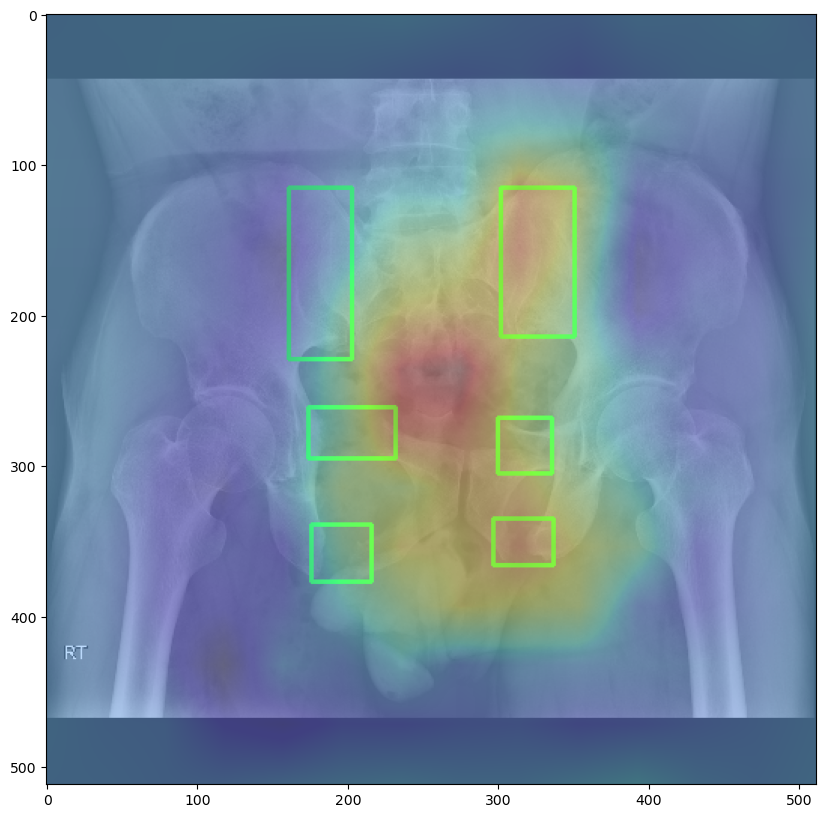

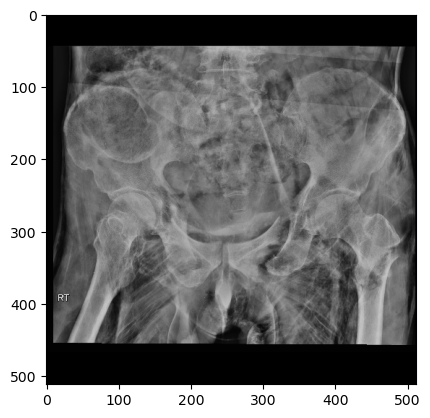

[316.54771784 252.6362379  347.88381743 319.55739972]
[316 252 347 319]
[279.36929461 333.36652835 327.17012448 372.13831259]
[279 333 327 372]
[373.90871369  73.1175657  489.16182573 165.00138313]
[373  73 489 165]
[147.12033195 107.64038728 211.91701245 210.67773167]
[147 107 211 210]
[307.5186722  111.3582296  356.38174274 215.45781466]
[307 111 356 215]
[246.43983402 123.57399723 289.46058091 212.802213  ]
[246 123 289 212]
[162.52282158 329.1175657  220.94605809 380.10511757]
[162 329 220 380]
[144.46473029 234.57814661 196.51452282 306.81051176]
[144 234 196 306]
result : 2, True : 2


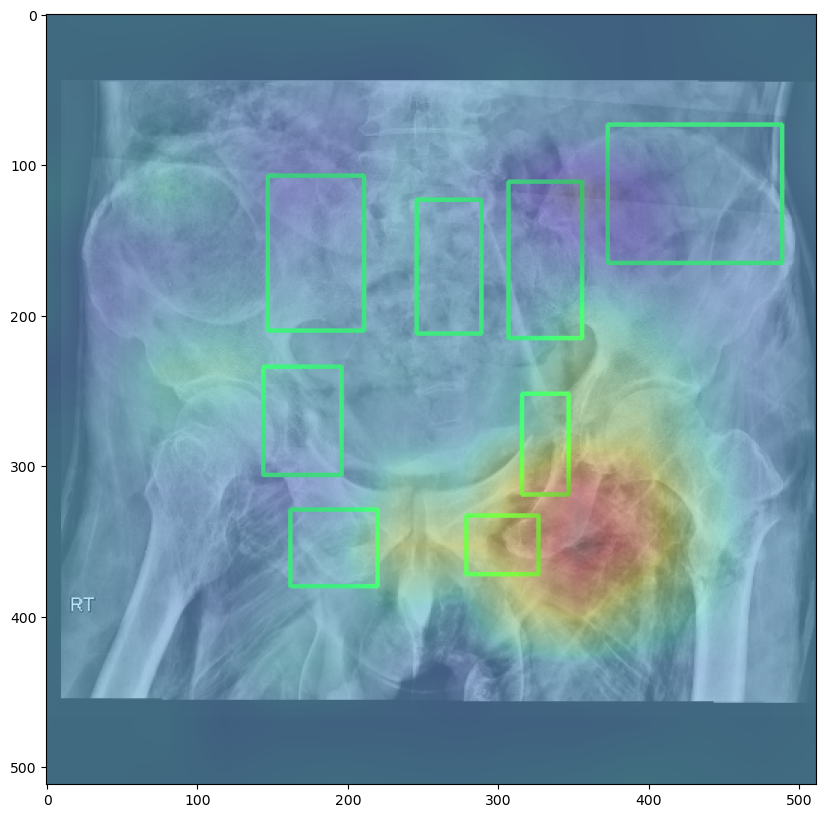

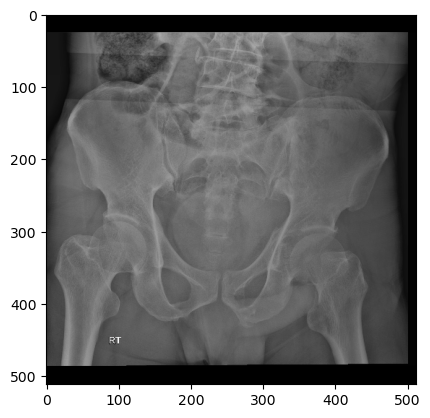

[302.34482759 136.45977011 331.5862069  186.11494253]
[302 136 331 186]
[305.10344828 289.28735632 334.89655172 339.49425287]
[305 289 334 339]
[258.20689655 396.32183908 297.93103448 436.04597701]
[258 396 297 436]
[178.20689655 397.42528736 209.10344828 424.45977011]
[178 397 209 424]
[300.68965517 196.59770115 350.34482759 241.83908046]
[300 196 350 241]
result : 0, True : 1


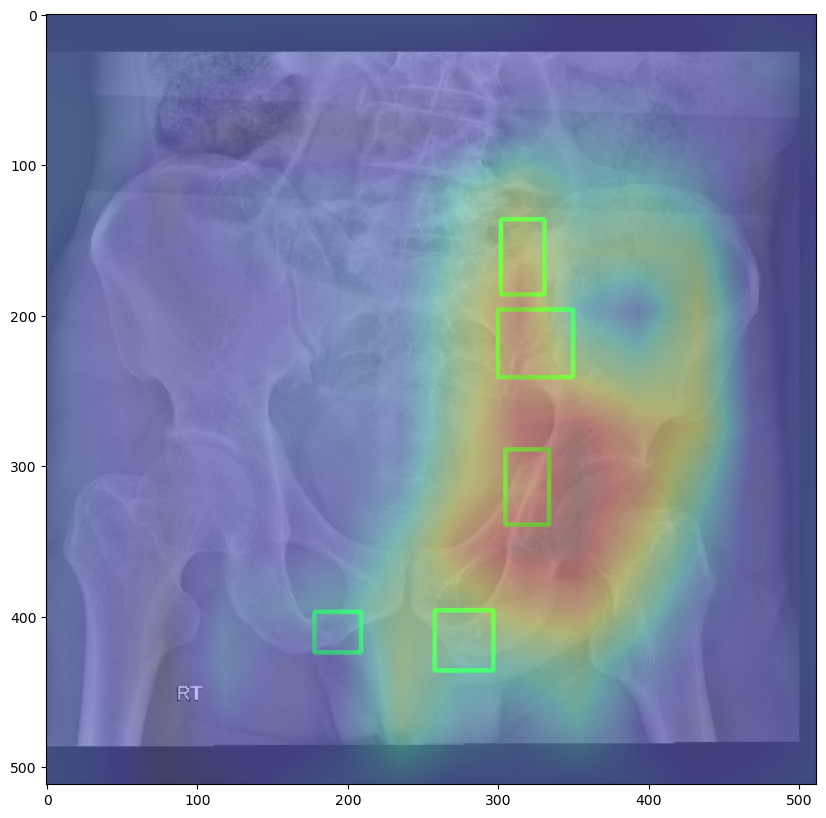

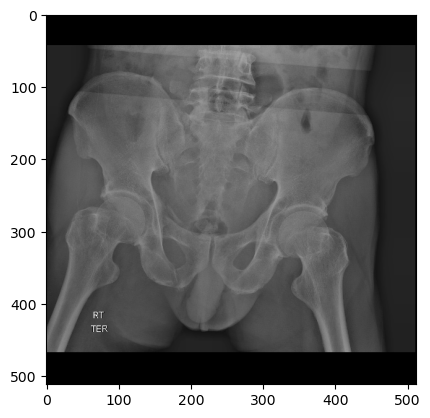

[149.9525066  250.59630607 182.37467018 308.34828496]
[149 250 182 308]
[166.16358839 342.29023747 191.49340369 384.33773087]
[166 342 191 384]
[261.91029024 288.59102902 293.31926121 323.03957784]
[261 288 293 323]
[255.32453826 347.86279683 311.05013193 384.33773087]
[255 347 311 384]
[168.69656992 114.32189974 216.823219   221.21372032]
[168 114 216 221]
result : 0, True : 0


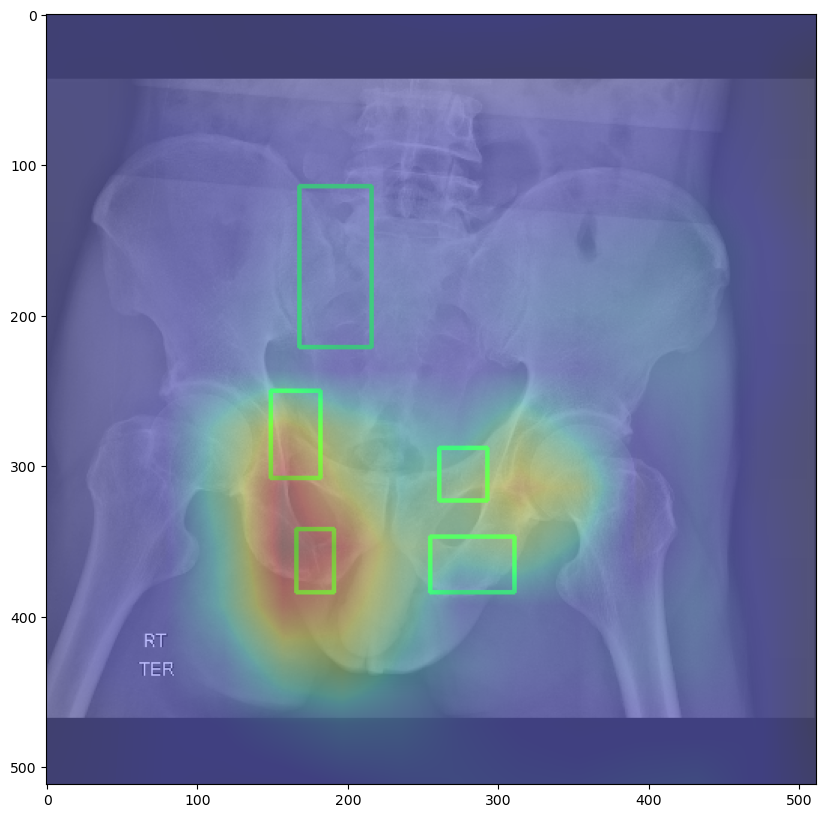

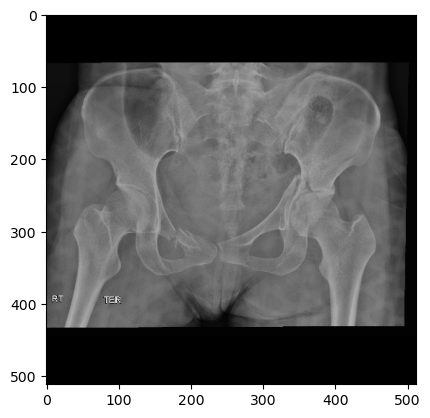

[164.19672131 284.32786885 219.80327869 325.7704918 ]
[164 284 219 325]
[142.68852459 330.49180328 179.93442623 362.49180328]
[142 330 179 362]
[267.01639344 327.86885246 297.44262295 355.14754098]
[267 327 297 355]
[323.14754098 210.36065574 372.98360656 266.49180328]
[323 210 372 266]
[394.49180328 188.32786885 429.63934426 223.47540984]
[394 188 429 223]
[274.8852459   99.14754098 317.90163934 222.95081967]
[274  99 317 222]
result : 1, True : 1


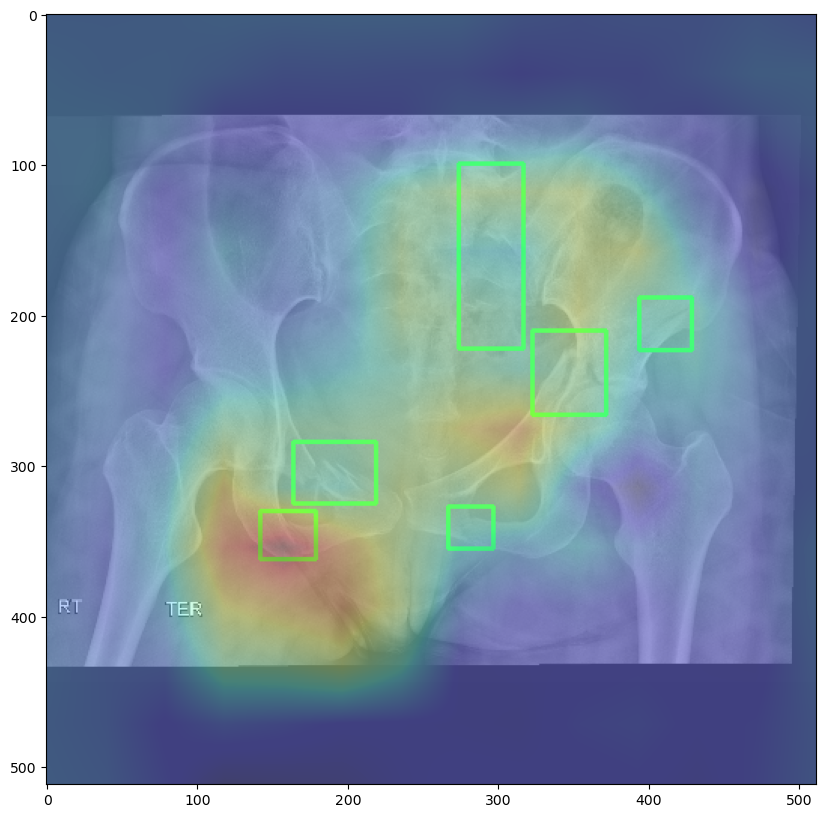

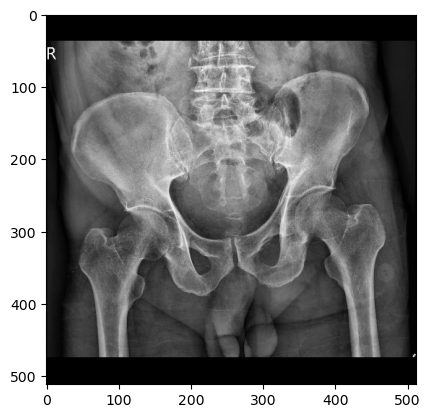

[262.78554217 278.36144578 331.25783133 325.24337349]
[262 278 331 325]
[269.57108434 327.0939759  312.13493976 367.80722892]
[269 327 312 367]
result : 0, True : 0


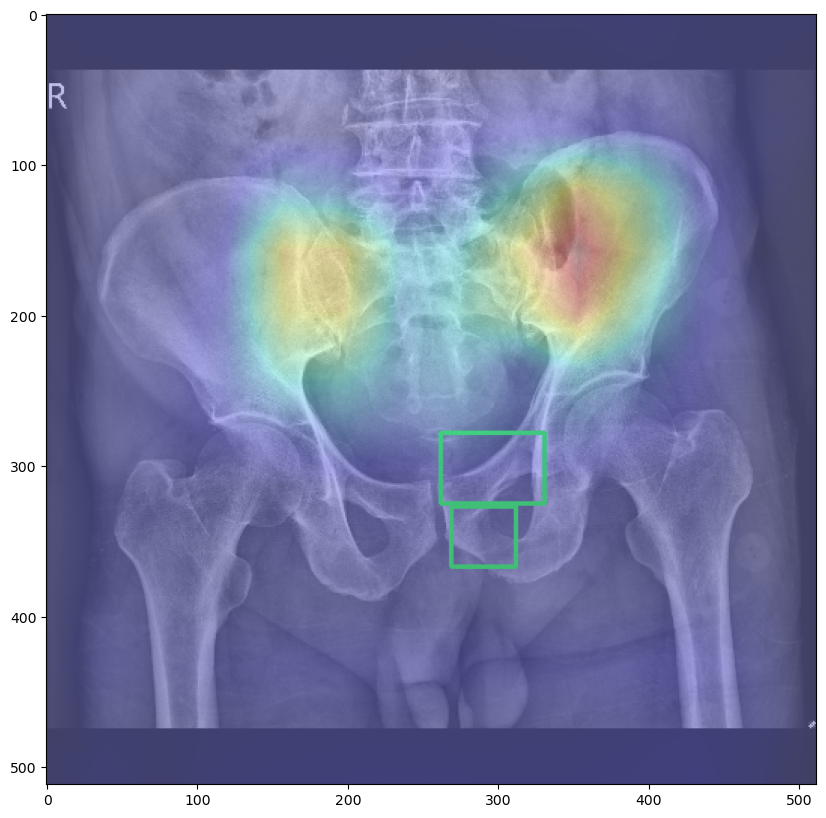

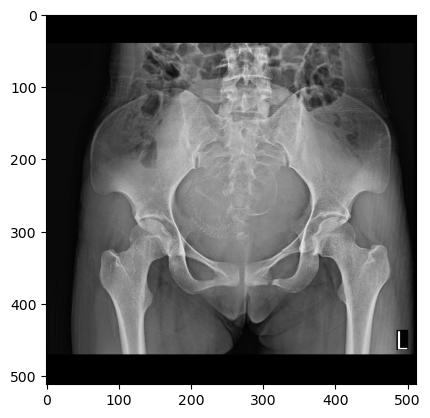

[294.         360.90909091 346.90909091 381.63636364]
[294 360 346 381]
[318.54545455 318.90909091 360.         333.63636364]
[318 318 360 333]
result : 0, True : 0


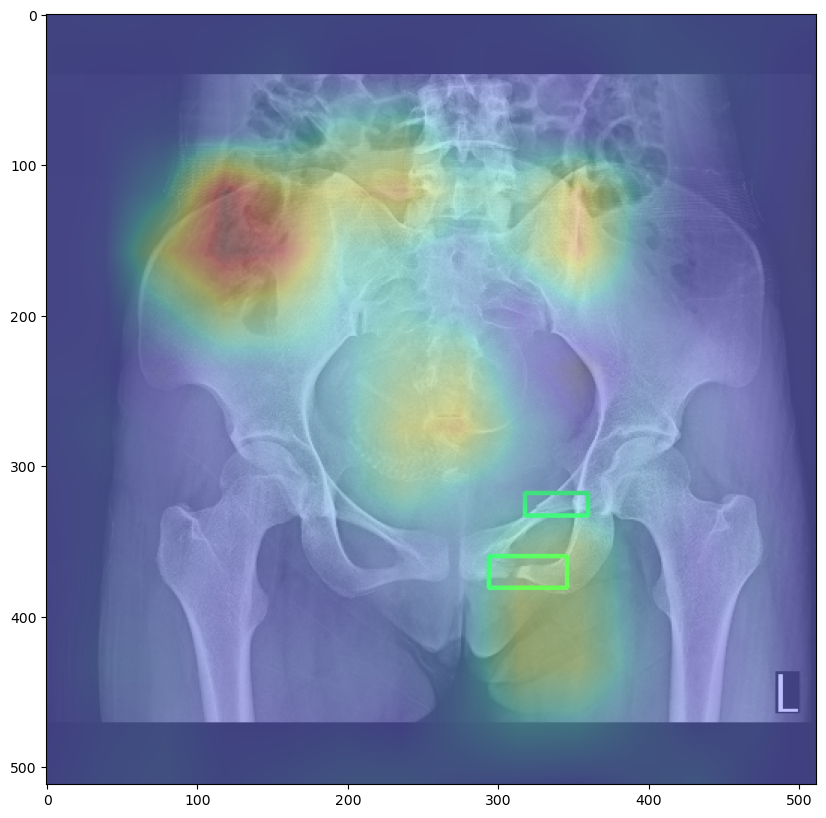

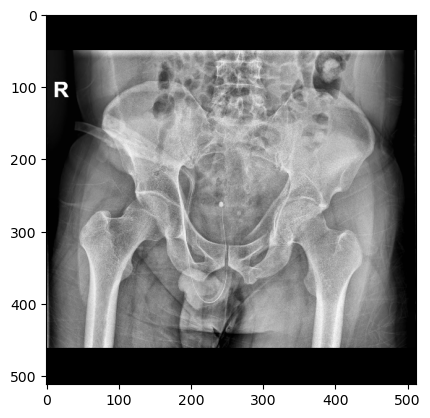

[281.36775994 288.69225401 315.66782973 321.38450803]
[281 288 315 321]
[273.32868109 344.965806   313.52407537 375.51430565]
[273 344 313 375]
[347.28820656  95.75436148 396.05861828 240.99371947]
[347  95 396 240]
[302.80530356 235.63433357 343.00069784 265.64689463]
[302 235 343 265]
result : 1, True : 1


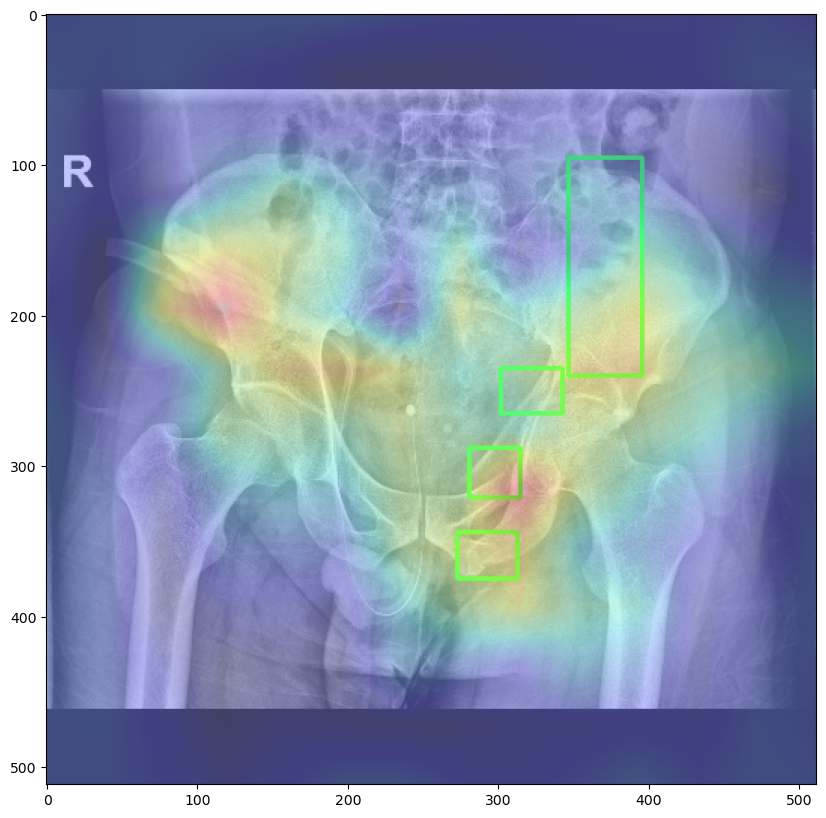

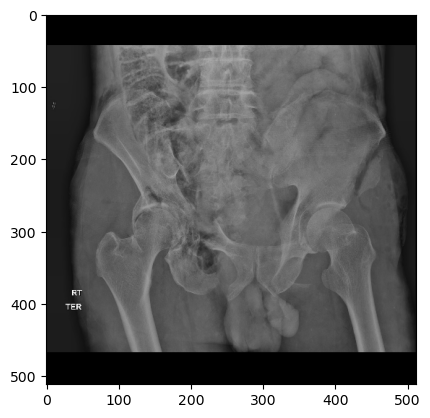

[231.00791557 353.4353562  259.88390501 398.52242744]
[231 353 259 398]
[192.         263.26121372 237.59366755 329.62532982]
[192 263 237 329]
[304.46437995 356.98153034 326.24802111 396.49604222]
[304 356 326 396]
[320.67546174 294.6701847  356.64379947 340.77044855]
[320 294 356 340]
[162.61741425 129.01319261 233.5408971  251.10290237]
[162 129 233 251]
[420.98153034 164.98153034 464.04221636 251.10290237]
[420 164 464 251]
result : 2, True : 2


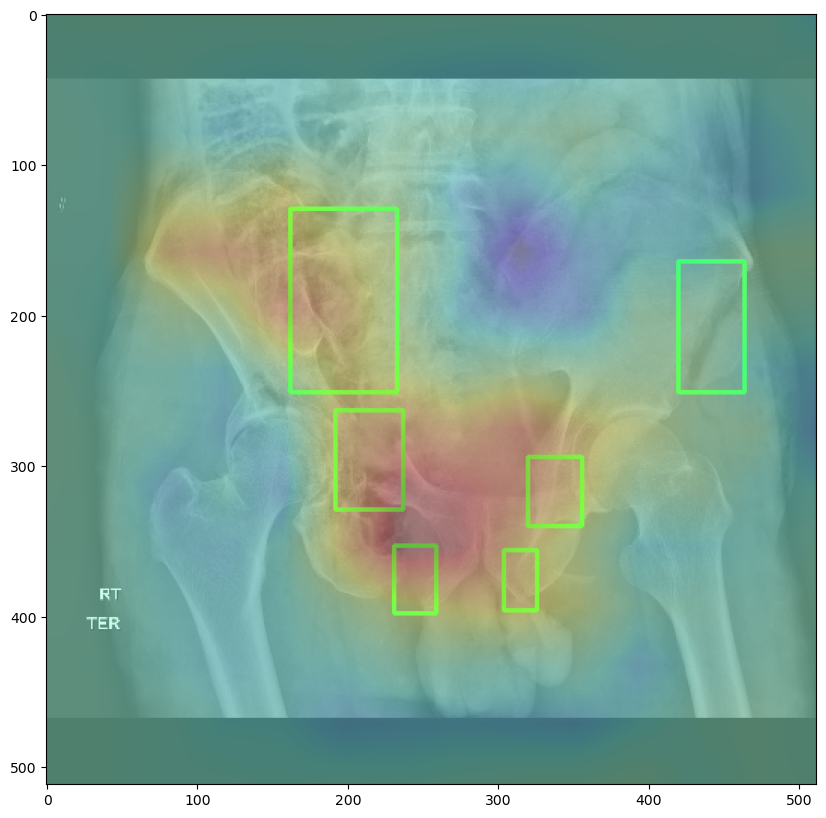

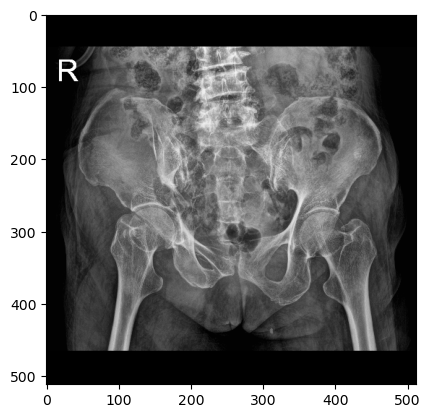

[ 92.6381323  102.93125811 150.91050584 181.12581064]
[ 92 102 150 181]
[157.88326848 121.85732815 225.61867704 275.75616083]
[157 121 225 275]
result : 1, True : 1


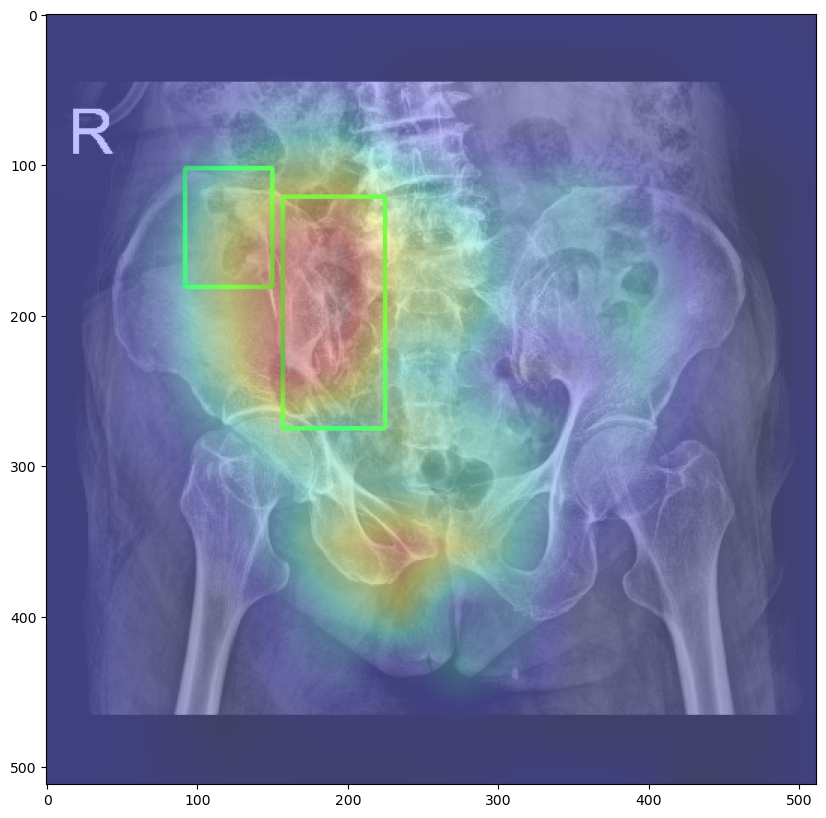

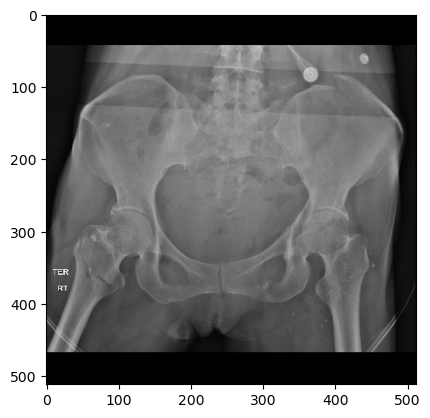

[362.21635884  84.43271768 421.48812665 223.74670185]
[362  84 421 223]
[277.10817942 113.30870712 332.83377309 243.50395778]
[277 113 332 243]
[187.94722955 104.69656992 262.92348285 258.19525066]
[187 104 262 258]
[324.22163588 275.92612137 359.68337731 346.84960422]
[324 275 359 346]
[295.85224274 365.59366755 320.16886544 402.06860158]
[295 365 320 402]
result : 0, True : 1


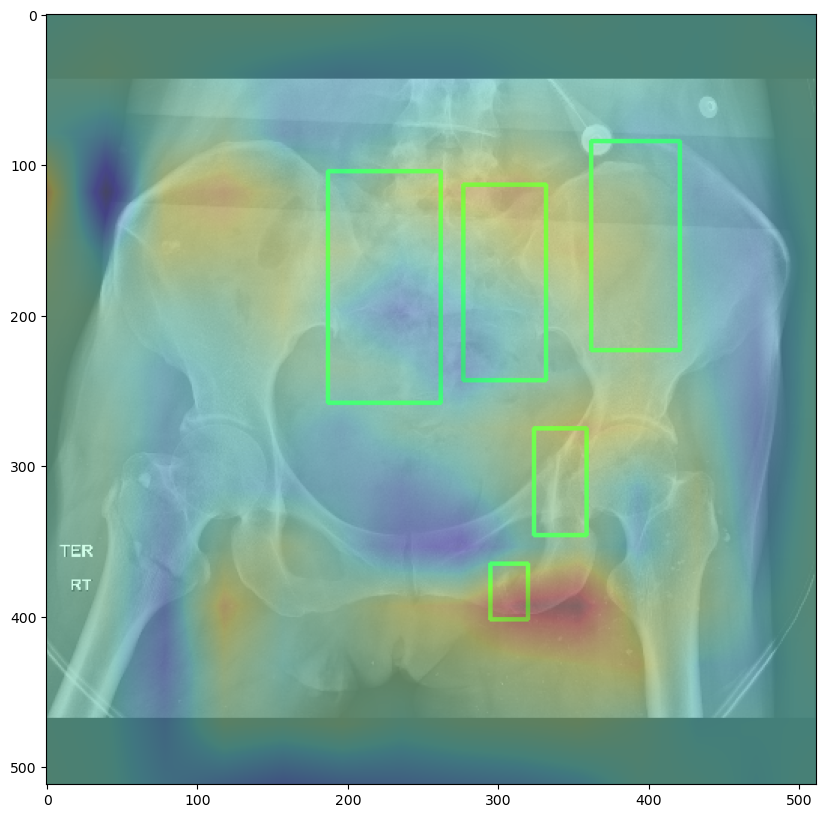

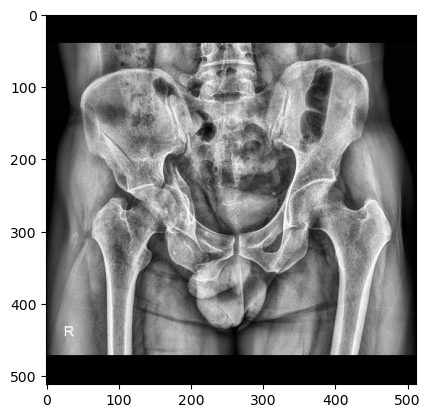

[201.25148515 336.4330033  229.63960396 370.90429043]
[201 336 229 370]
[ 52.72079208 140.25082508 133.32277228 238.59537954]
[ 52 140 133 238]
[150.05148515 202.09636964 225.07722772 313.11419142]
[150 202 225 313]
result : 0, True : 0


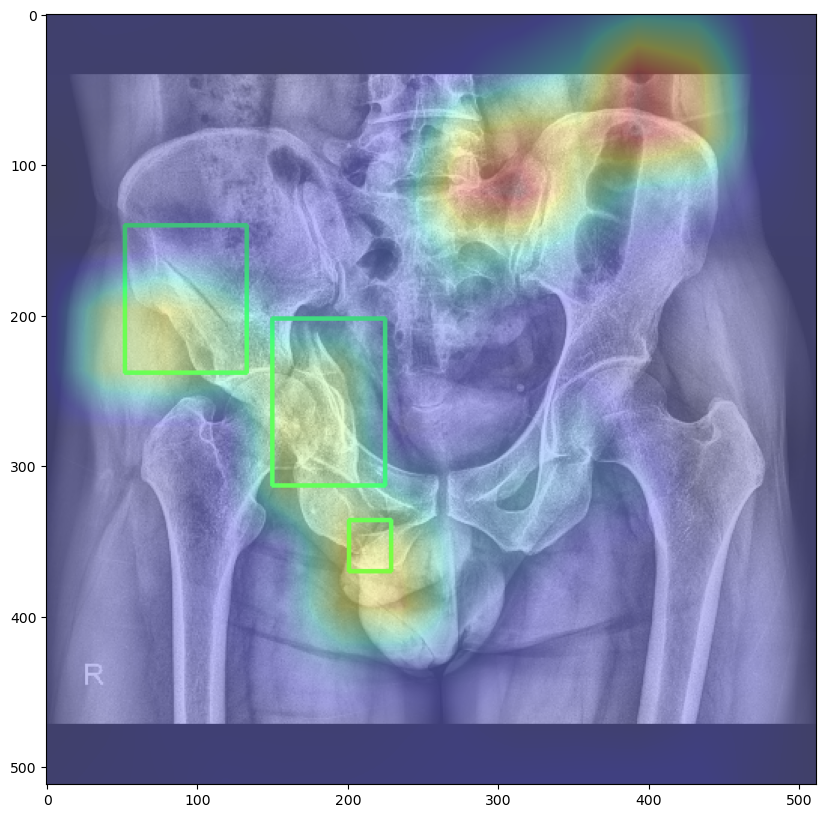

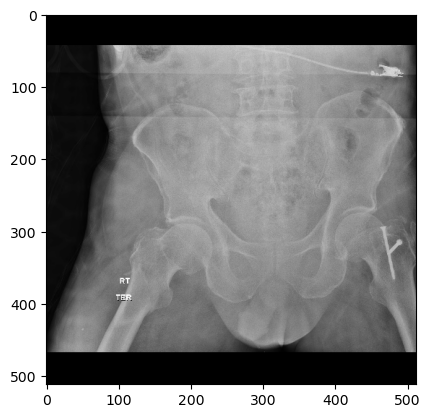

[231.51451187 275.92612137 259.37730871 335.19788918]
[231 275 259 335]
[155.01846966 177.64643799 218.84960422 280.48548813]
[155 177 218 280]
result : 0, True : 0


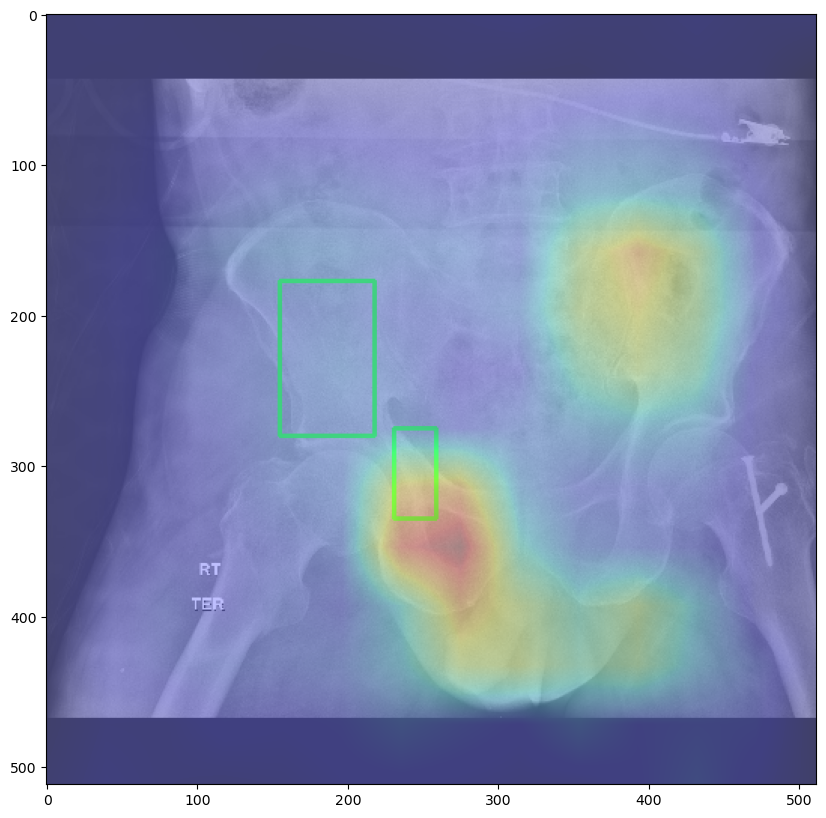

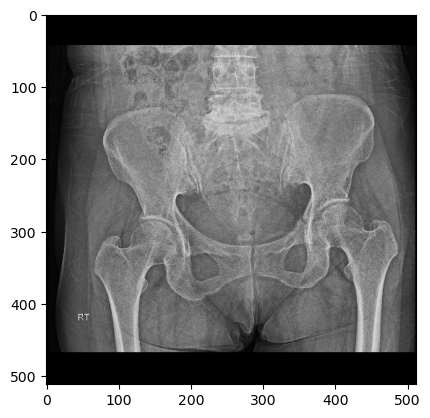

[340.43271768 180.68601583 371.84168865 244.5171504 ]
[340 180 371 244]
[344.48548813 272.37994723 368.80211082 313.92084433]
[344 272 368 313]
[345.49868074 349.38258575 368.80211082 382.81794195]
[345 349 368 382]
result : 1, True : 1


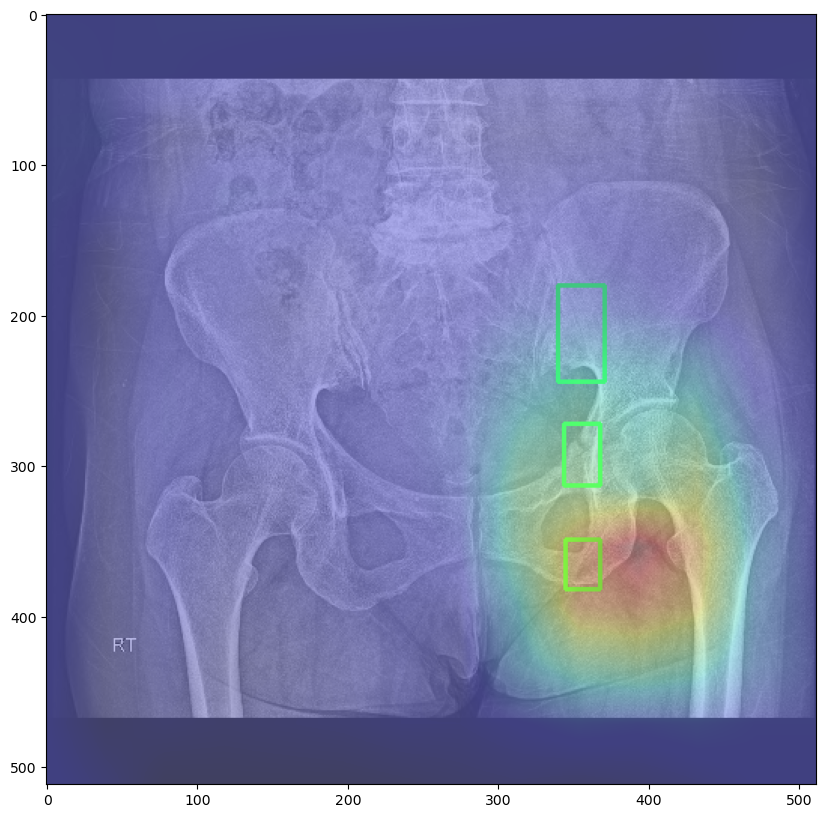

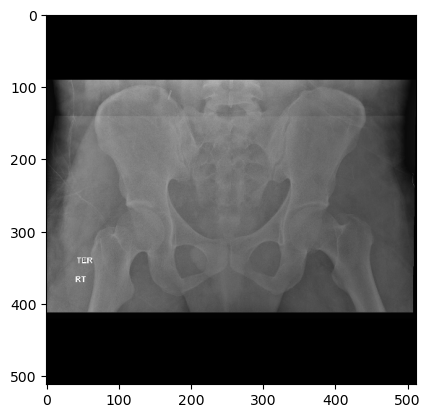

[168.46778989 270.12355467 208.55500496 306.15130492]
[168 270 208 306]
[180.64618434 123.47538817 235.95639247 217.85794516]
[180 123 235 217]
result : 0, True : 0


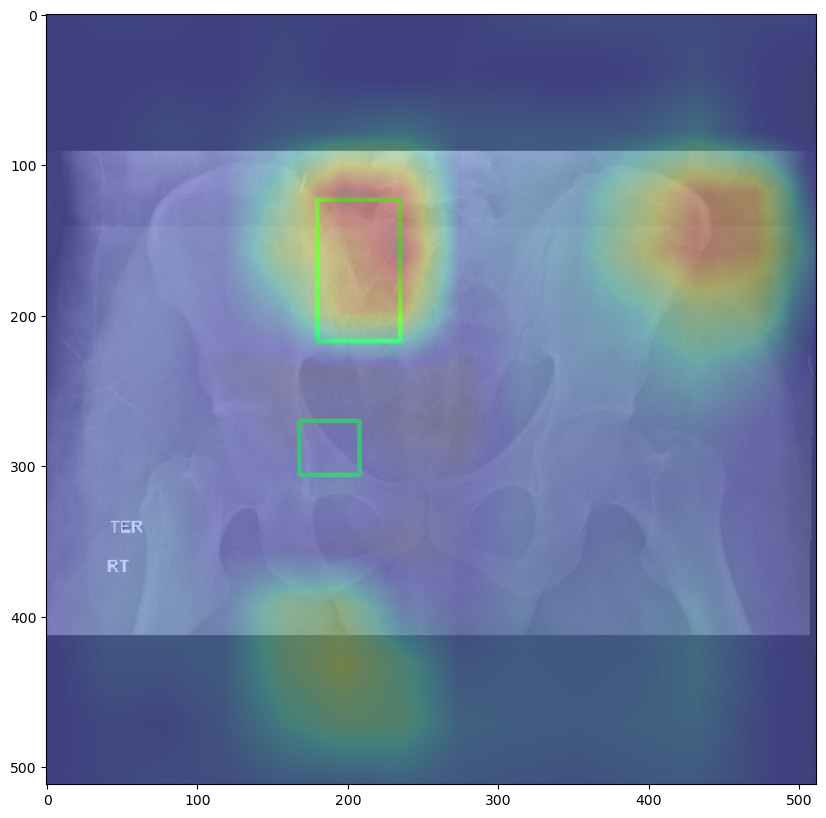

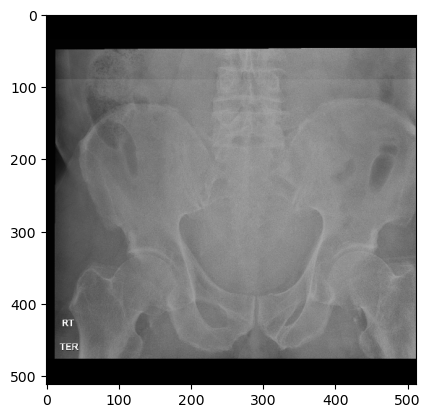

[301.01316809 387.66847405 330.1626646  448.34701782]
[301 387 330 448]
[347.41440744 341.86212239 371.80480248 393.02246321]
[347 341 371 393]
result : 2, True : 2


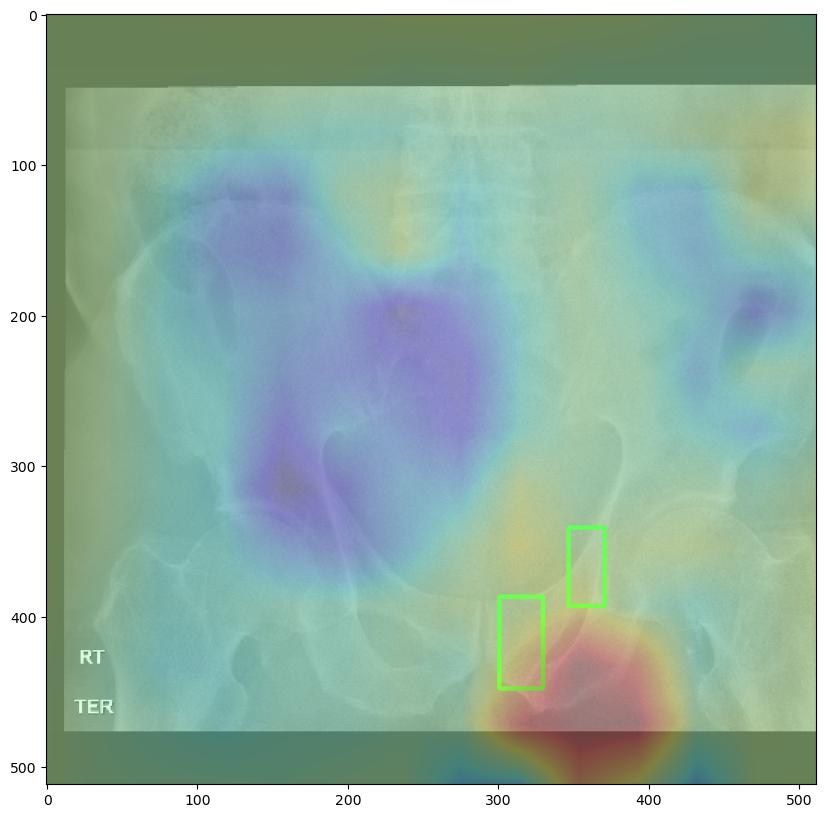

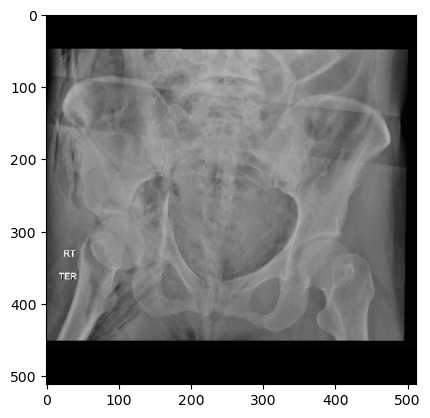

[111.62625139 216.79792362 173.13459399 282.29291806]
[111 216 173 282]
[ 27.90656285 108.58880237 103.65294772 256.09492028]
[ 27 108 103 256]
[247.17241379 359.17834631 297.85984427 400.18390805]
[247 359 297 400]
[193.63737486 362.59547646 240.3381535  413.85242862]
[193 362 240 413]
[148.0756396  291.9747868  183.95550612 348.35743419]
[148 291 183 348]
[149.78420467 120.54875788 200.47163515 211.10270671]
[149 120 200 211]
[290.45606229 411.57434186 321.21023359 440.0504264 ]
[290 411 321 440]
[169.14794216 388.79347423 185.66407119 421.8257323 ]
[169 388 185 421]
result : 2, True : 2


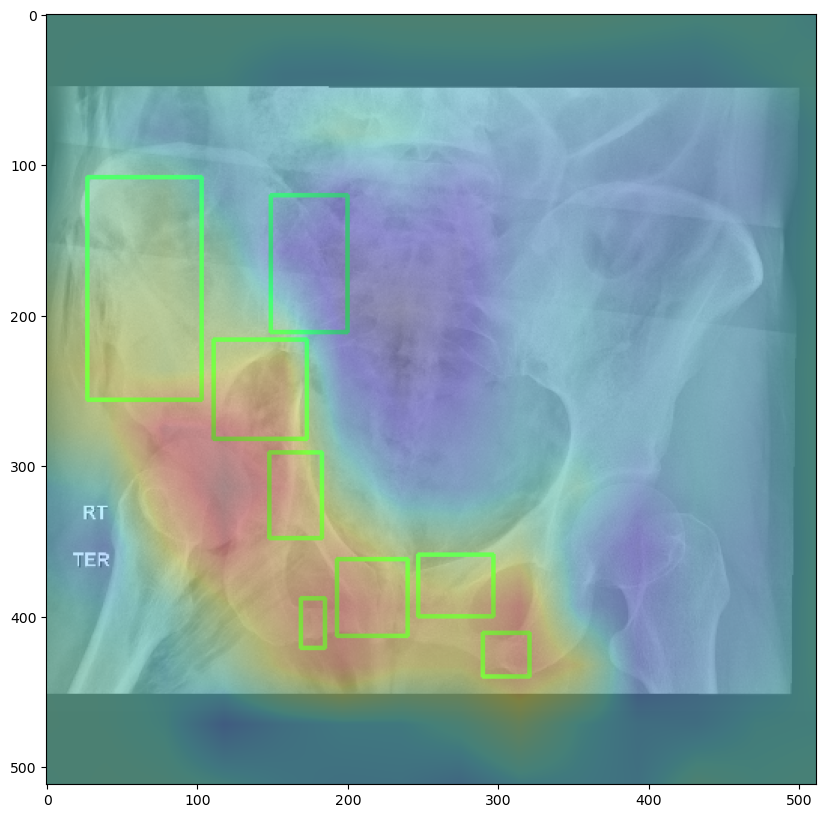

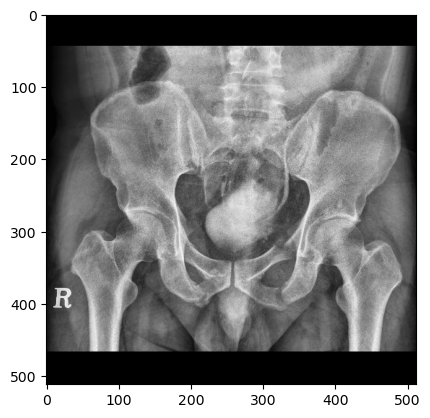

[182.8056338  116.28169014 217.96056338 229.85915493]
[182 116 217 229]
[311.52676056 306.11830986 346.68169014 342.35492958]
[311 306 346 342]
[308.28169014 372.10140845 349.38591549 412.66478873]
[308 372 349 412]
[184.42816901 294.21971831 207.68450704 347.76338028]
[184 294 207 347]
[196.86760563 366.15211268 227.15492958 407.7971831 ]
[196 366 227 407]
result : 1, True : 1


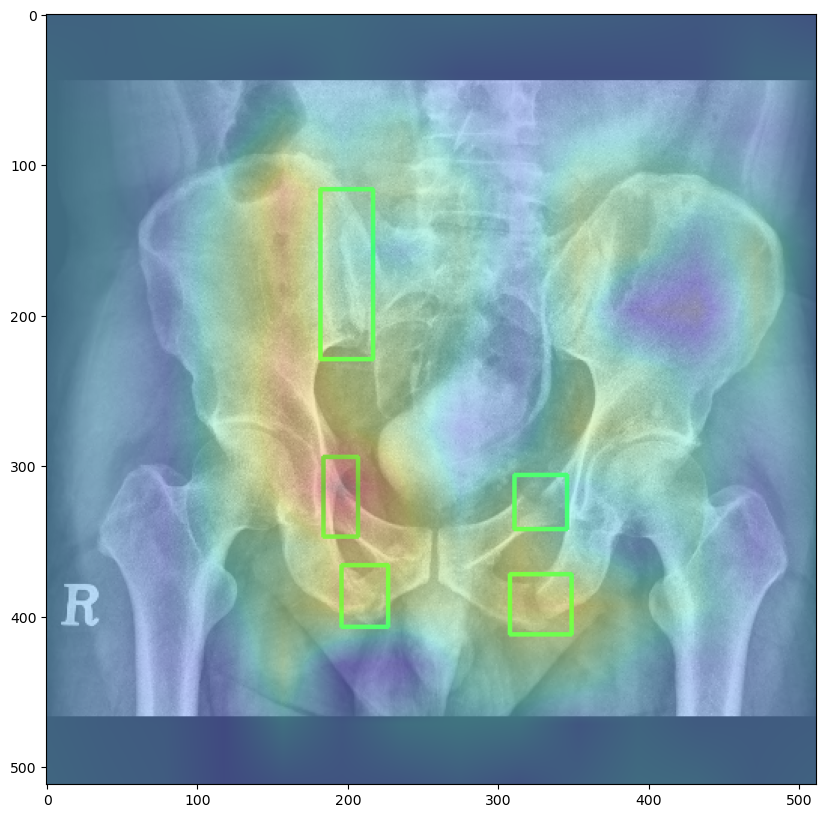

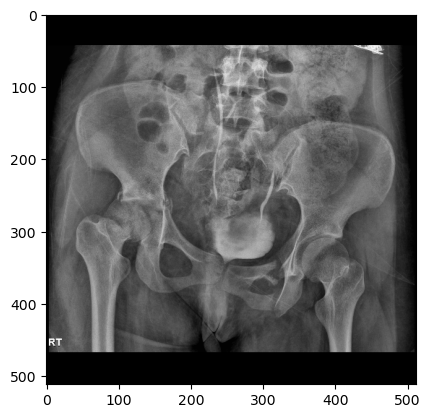

[148.17527796 249.3028123  182.33093525 290.49051668]
[148 249 182 290]
[160.73250491  96.60693264 241.60104644 233.73185088]
[160  96 241 233]
[302.37802485 327.65990844 332.51536952 378.3911053 ]
[302 327 332 378]
[300.36886854 382.911707   333.51994768 421.08567691]
[300 382 333 421]
[228.03924133 327.15761936 261.19032047 391.9529104 ]
[228 327 261 391]
result : 1, True : 1


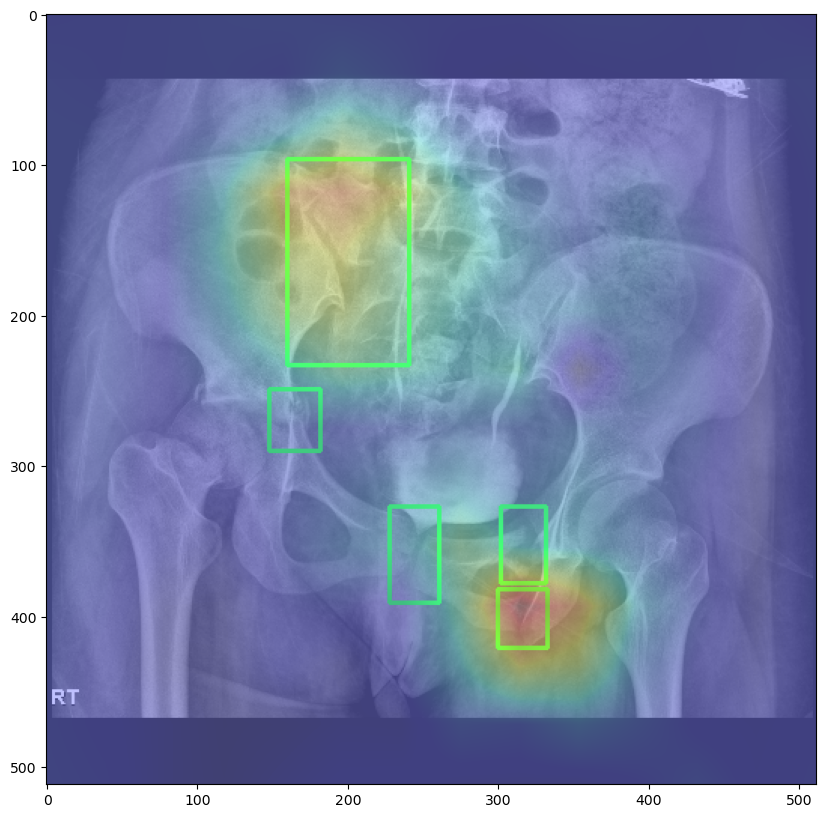

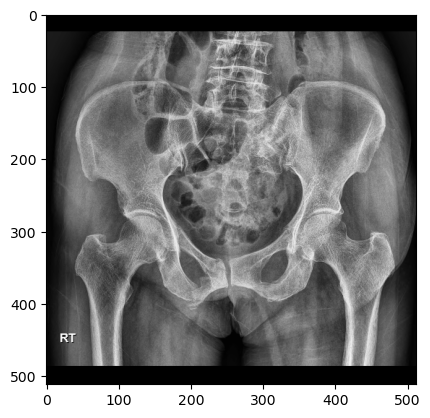

[169.86011342 283.82608696 196.71833648 331.0094518 ]
[169 283 196 331]
[218.4952741  331.0094518  251.88657845 365.12665406]
[218 331 251 365]
[182.20037807 366.57844991 217.76937618 410.13232514]
[182 366 217 410]
[320.12098299 286.00378072 349.88279773 327.37996219]
[320 286 349 327]
[301.24763705 363.67485822 346.97920605 397.06616257]
[301 363 346 397]
[307.78071834 132.11342155 348.43100189 222.85066163]
[307 132 348 222]
result : 0, True : 1


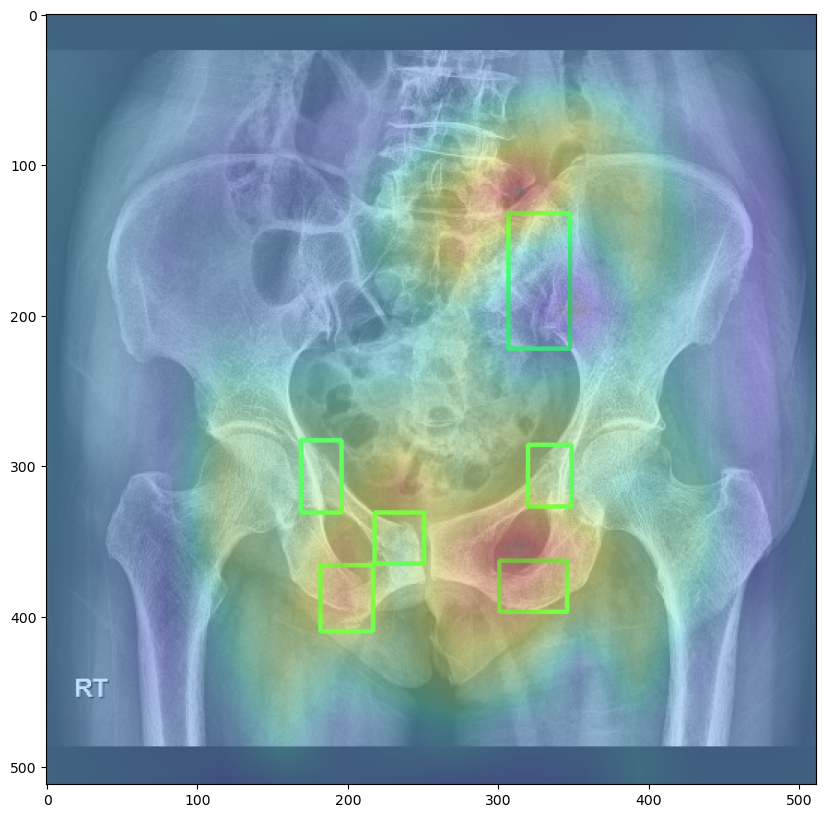

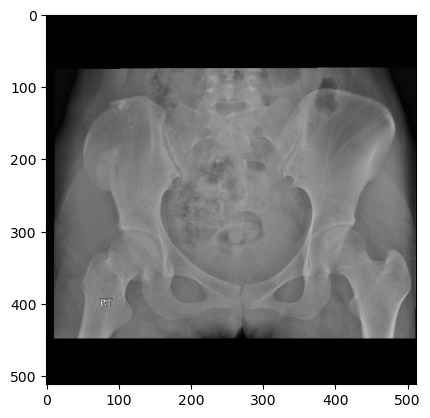

[ 79.32649452 115.1864167  150.50300672 175.49628582]
[ 79 115 150 175]
result : 0, True : 0


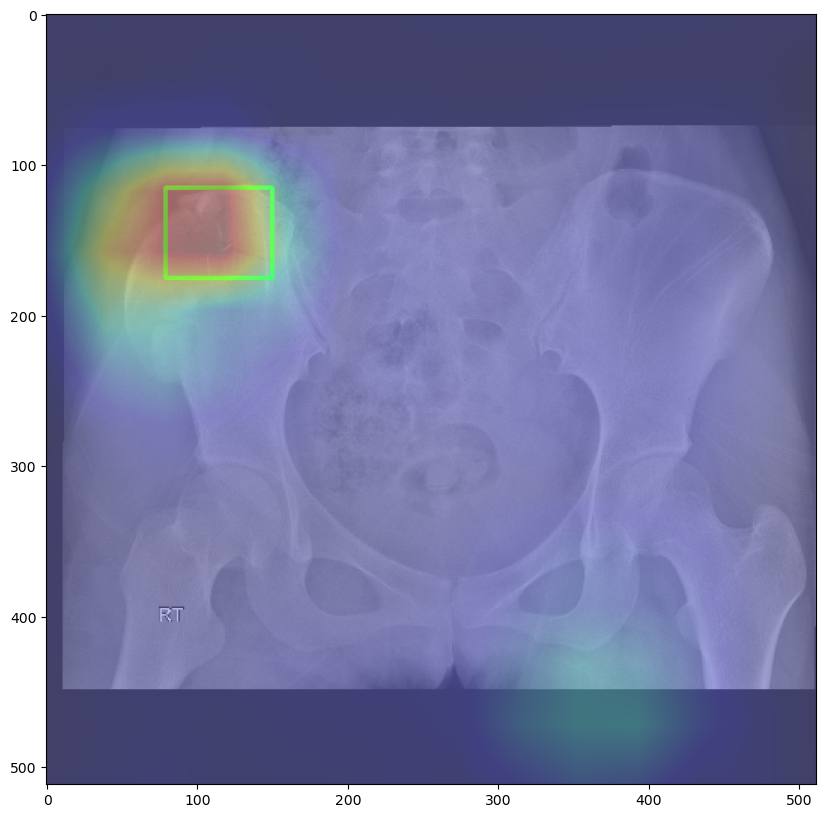

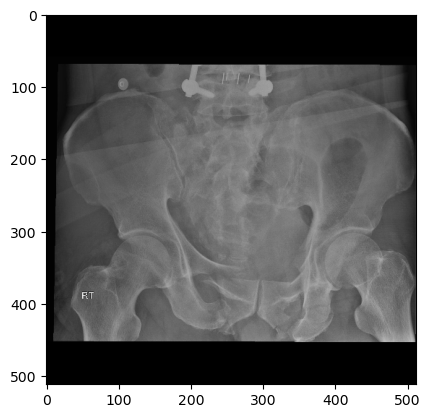

[167.69274538 124.17638691 233.24039829 270.01991465]
[167 124 233 270]
[207.02133713 335.02133713 273.11522048 387.45945946]
[207 335 273 387]
[231.05547653 392.37553343 268.19914651 446.45234708]
[231 392 268 446]
[332.10810811 342.12233286 368.70554765 397.2916074 ]
[332 342 368 397]
[297.69559033 415.86344239 369.79800853 452.46088193]
[297 415 369 452]
[321.72972973 123.63015647 352.31863442 179.89189189]
[321 123 352 179]
[197.73541963 276.57467994 262.19061166 330.6514936 ]
[197 276 262 330]
result : 0, True : 2


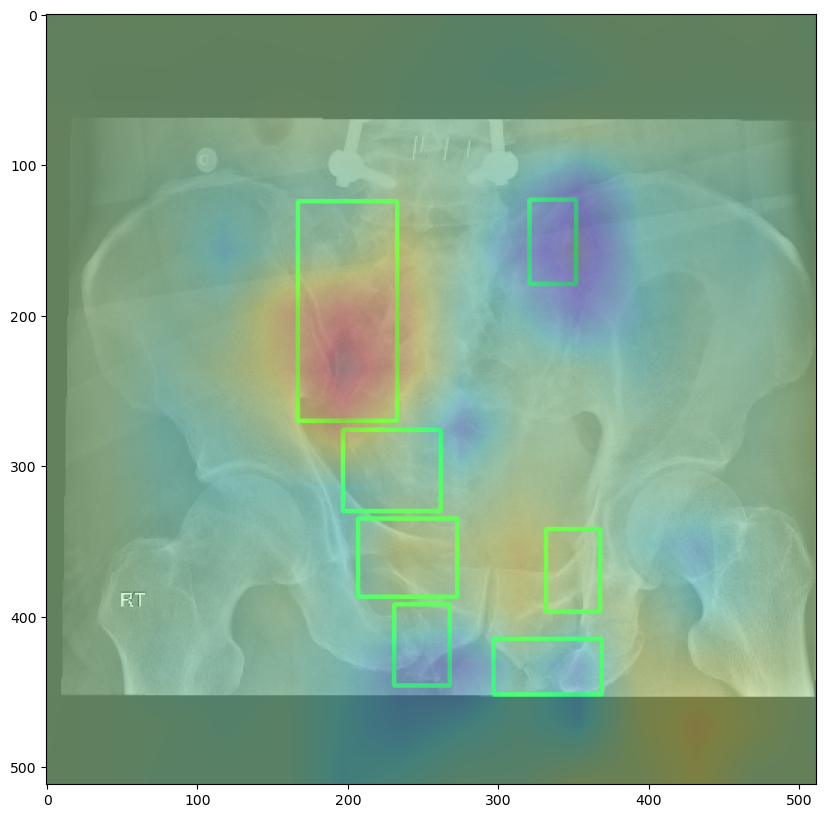

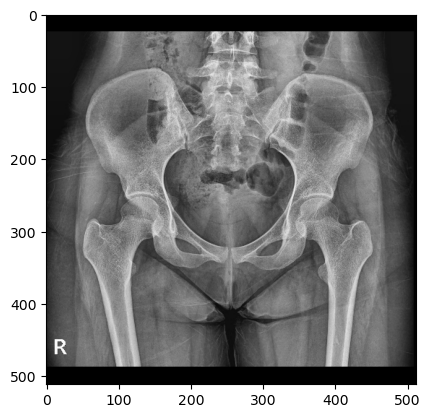

[nan nan nan nan]
[-9223372036854775808 -9223372036854775808 -9223372036854775808
 -9223372036854775808]
result : 3, True : 3


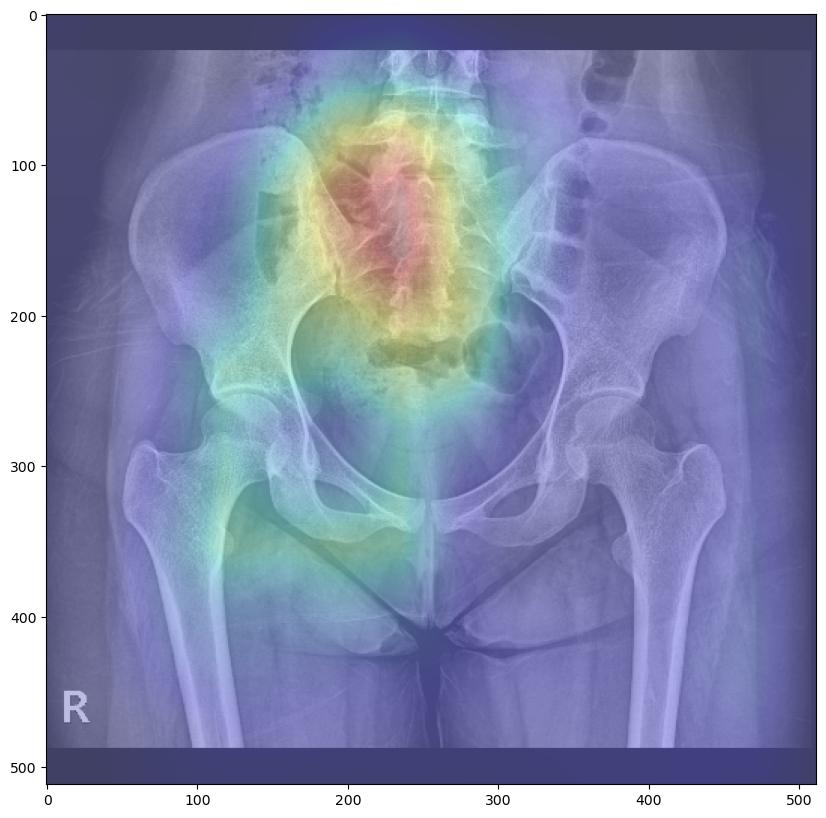

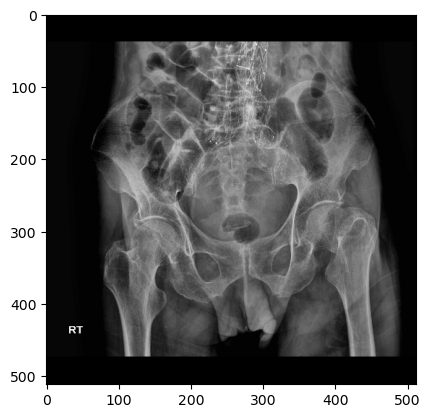

[nan nan nan nan]
[-9223372036854775808 -9223372036854775808 -9223372036854775808
 -9223372036854775808]
result : 3, True : 3


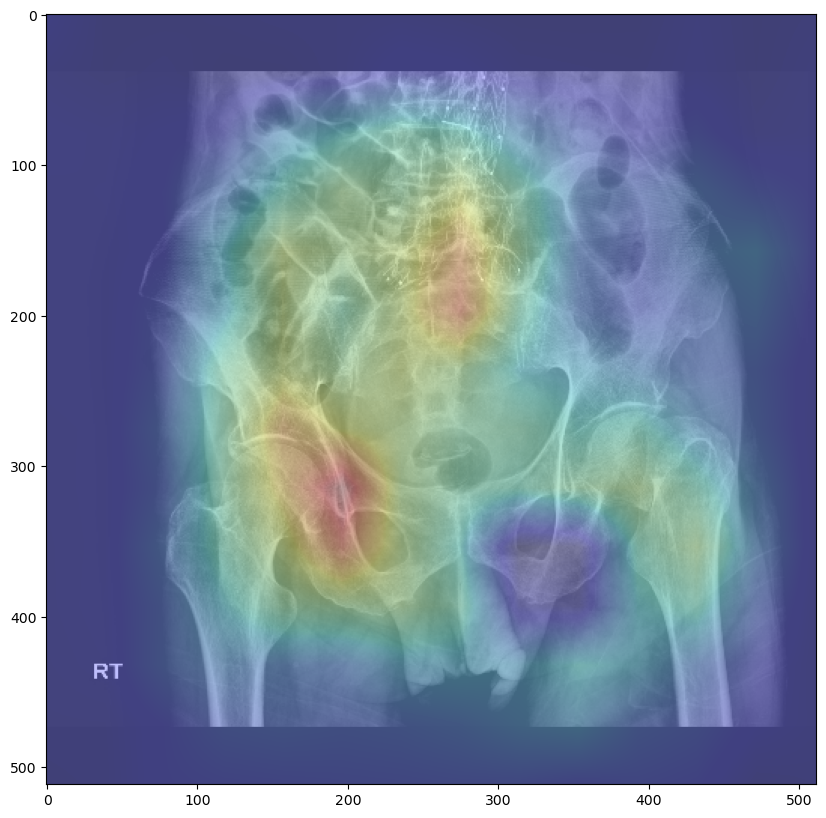

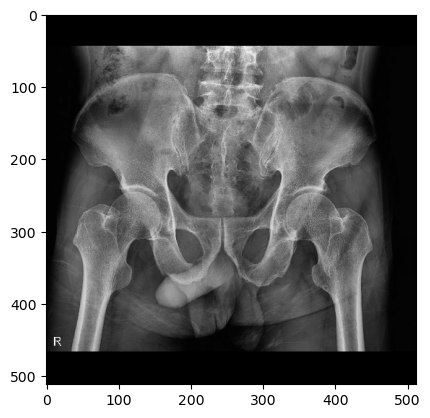

[nan nan nan nan]
[-9223372036854775808 -9223372036854775808 -9223372036854775808
 -9223372036854775808]


In [ ]:
import scipy as sp
import tensorflow as tf
import cv2

for i in range(len(y_test_2)):
    test_i = np.expand_dims(x_test[i],0)
    test_m = np.expand_dims(x_mask[i],0)
    img,lbl = [test_i,test_m],int(y_test_2[i])
    D_box = box.loc[box['path']==name[i]].iloc[:,2:6].values 
    features,results = cam_model.predict(img,verbose=0)
    test_i = np.squeeze(test_i,0)
    plt.imshow(test_i)
    plt.show()
#     img=((img+255)/2).astype("uint8")
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

    show_cam(test_i, features, results, lbl,D_box)

In [ ]:
box.loc[box['path']==name[i]].iloc[:,2:6]

In [ ]:
results

In [ ]:
model.summary()

In [ ]:
features.shape

In [ ]:
lbl

In [ ]:
box.loc[box['name']==name[i]].iloc[:,1:5].values